# Setup pipeline and initialize the three models

In [1]:
%load_ext autoreload

import os, sys
sys.path.insert(0, "../")

%autoreload 2
from flowset import *

import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300



from os import listdir
from os.path import isfile, join
from upsetplot import plot, from_contents,UpSet



In [2]:
def download_and_unzip(download_url_link, dir_path, zipped_filename,destination_dir_name):
    #https://www.tutorialsbuddy.com/download-and-unzip-a-zipped-file-in-python
    print("Download starting")
    urllib.request.urlretrieve(
        download_url_link, os.path.join(dir_path, zipped_filename)
    )
    print("Download complete")

    print("unzipping file starting")
    with zipfile.ZipFile(os.path.join(dir_path, zipped_filename), "r") as zip_file:
        zip_file.extractall(os.path.join(dir_path, destination_dir_name))
    print("unzipping complete")


if not os.path.exists("ReactomePathways.gmt"):
    download_and_unzip("https://reactome.org/download/current/ReactomePathways.gmt.zip", ".", "ReactomePathways.gmt.zip", ".")

In [3]:
exprData = pl.read_csv("./summarised_simulated_scdata_random.tsv", has_header=True, sep="\t", null_values=["NA"])
print(exprData)

shape: (60273, 13)
┌──────┬────────────┬───────────┬────────────┬─────┬────────────┬────────┬────────────┬────────────┐
│ clus ┆ count_expr ┆ min.clust ┆ lower_hing ┆ ... ┆ count_all. ┆ gene   ┆ not_expr.c ┆ expr.clust │
│ ter  ┆ .cluster   ┆ er        ┆ e.cluster  ┆     ┆ cluster    ┆ ---    ┆ luster     ┆ er         │
│ ---  ┆ ---        ┆ ---       ┆ ---        ┆     ┆ ---        ┆ str    ┆ ---        ┆ ---        │
│ str  ┆ i64        ┆ f64       ┆ f64        ┆     ┆ i64        ┆        ┆ f64        ┆ f64        │
╞══════╪════════════╪═══════════╪════════════╪═════╪════════════╪════════╪════════════╪════════════╡
│ clus ┆ 2541       ┆ 0.083077  ┆ 0.428374   ┆ ... ┆ 5419       ┆ GCLC   ┆ 0.531094   ┆ 0.468906   │
│ ter. ┆            ┆           ┆            ┆     ┆            ┆        ┆            ┆            │
│ knoc ┆            ┆           ┆            ┆     ┆            ┆        ┆            ┆            │
│ kout ┆            ┆           ┆            ┆     ┆            ┆       

In [4]:
exprData=exprData.with_columns(pl.col("cluster").str.replace("cluster.", "")  )    


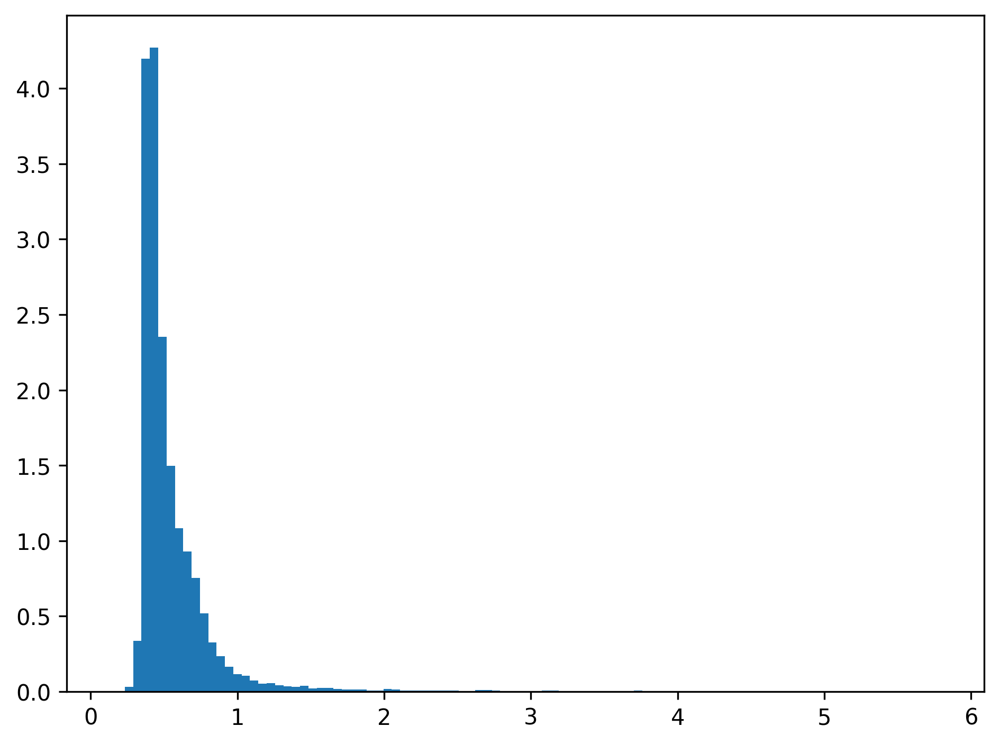

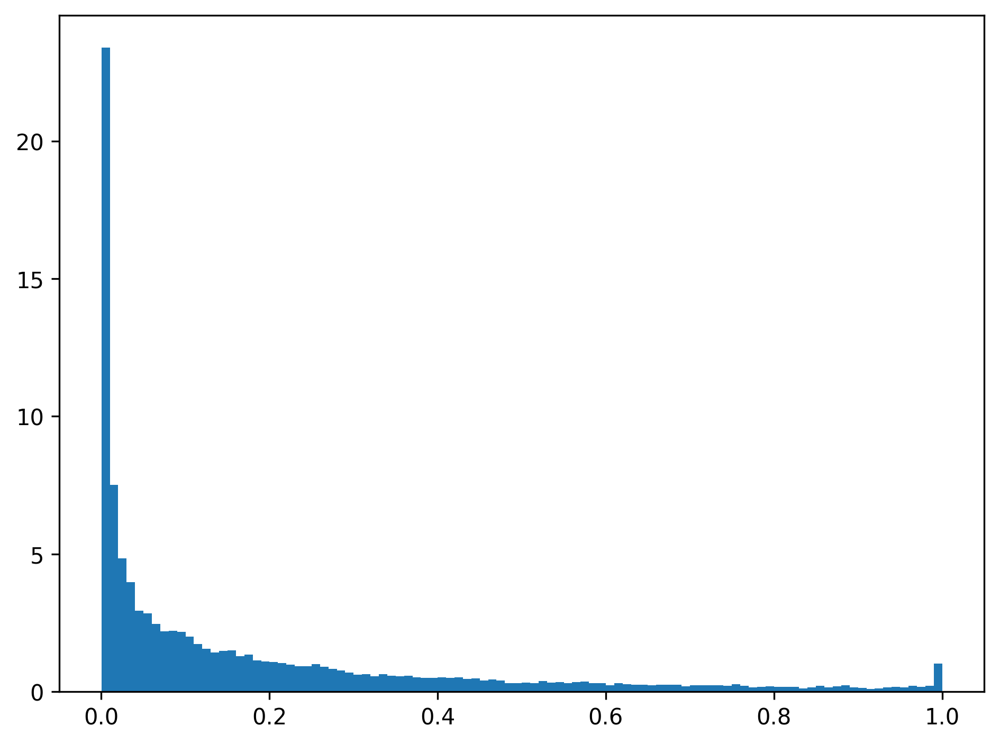

In [5]:
def pl_hist(df, column, n_bins=100,):
    data = df.select(pl.col(column))
    
    fig, ax = plt.subplots(1, 1, tight_layout=True)
    ax.hist(data, bins=n_bins, density=True)
    
    plt.show()
    plt.close()
pl_hist(exprData, "mean.cluster")
pl_hist(exprData, "expr.cluster")

{'seriesOrder': ['wildtype', 'knockout01', 'knockout02', 'knockout03']}
-1.0 9.0
centers [0.1, 0.5, 0.9, 1.3, 1.7, 2.1, 2.5]
Creating Universe Range -1.0 -> 9.0 with step size 0.1
Mean Expr mean.cluster col 7
Expr Count expr.cluster col 12
SD sd.cluster col 8
Cluster cluster col 0
Combining over state:  False


/home/o/offensperger/jupyterlab/FlowSets/benchmark_proc/../flowset.py:656: RuntimeWarning: invalid value encountered in divide
  values = fuzz.trimf(self.universe, abc)/unscaledValues


to_homogeneous: knockout02
to_homogeneous: knockout01
to_homogeneous: knockout03
to_homogeneous: wildtype
shape: (15072, 29)
┌──────────┬────────────┬────────────┬────────────┬─────┬────────────┬────────────┬───────────┬────────────┐
│ gene     ┆ HIGH.knock ┆ LOW.knocko ┆ LOWMED.kno ┆ ... ┆ MED.wildty ┆ MEDHIGH.wi ┆ NO.wildty ┆ NOLOW.wild │
│ ---      ┆ out02      ┆ ut02       ┆ ckout02    ┆     ┆ pe         ┆ ldtype     ┆ pe        ┆ type       │
│ str      ┆ ---        ┆ ---        ┆ ---        ┆     ┆ ---        ┆ ---        ┆ ---       ┆ ---        │
│          ┆ f64        ┆ f64        ┆ f64        ┆     ┆ f64        ┆ f64        ┆ f64       ┆ f64        │
╞══════════╪════════════╪════════════╪════════════╪═════╪════════════╪════════════╪═══════════╪════════════╡
│ C1orf112 ┆ 0.0        ┆ 0.003825   ┆ 0.0        ┆ ... ┆ 0.0        ┆ 0.0        ┆ 0.956584  ┆ 0.040429   │
│ GCLC     ┆ 0.0        ┆ 0.173338   ┆ 0.088188   ┆ ... ┆ 0.011274   ┆ 0.0        ┆ 0.586233  ┆ 0.159919   │
│ L

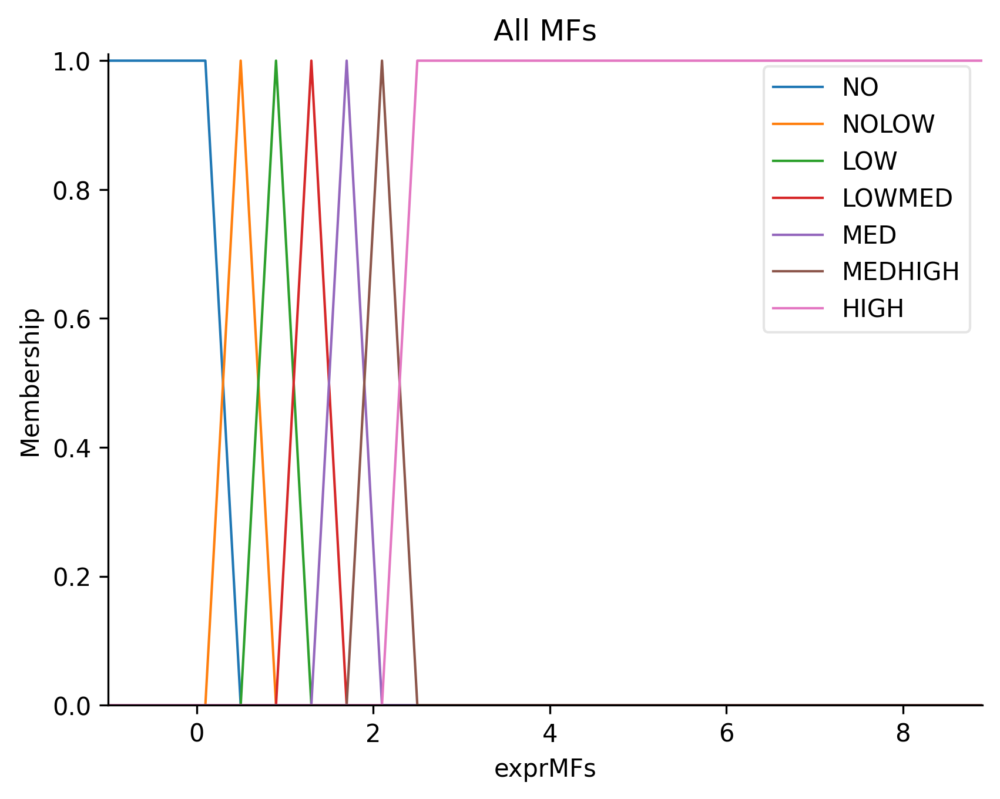

In [6]:
explDFRaw, mfFuzzy = FlowAnalysis.fuzzify_exprvalues(exprData, stepsize=0.1,seriesOrder=["wildtype", "knockout01", "knockout02", "knockout03"],mfLevels = ["NO","NOLOW","LOW","LOWMED","MED","MEDHIGH","HIGH"],centers=[.1,.5,.9,1.3,1.7,2.1,2.5])
explDFWide = FlowAnalysis.to_vwide(explDFRaw, mfFuzzy)
print(explDFWide)

In [7]:
explDFWide

gene,HIGH.knockout02,LOW.knockout02,LOWMED.knockout02,MED.knockout02,MEDHIGH.knockout02,NO.knockout02,NOLOW.knockout02,HIGH.knockout01,LOW.knockout01,LOWMED.knockout01,MED.knockout01,MEDHIGH.knockout01,NO.knockout01,NOLOW.knockout01,HIGH.knockout03,LOW.knockout03,LOWMED.knockout03,MED.knockout03,MEDHIGH.knockout03,NO.knockout03,NOLOW.knockout03,HIGH.wildtype,LOW.wildtype,LOWMED.wildtype,MED.wildtype,MEDHIGH.wildtype,NO.wildtype,NOLOW.wildtype
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64
"""C1orf112""",0.0,0.003825,0.0,0.0,0.0,0.953971,0.042204,0.0,0.002824,0.0,0.0,0.0,0.956153,0.041023,0.0,0.004454,0.0,0.0,0.0,0.951097,0.044449,0.0,0.002987,0.0,0.0,0.0,0.956584,0.040429
"""GCLC""",0.0,0.173338,0.088188,0.004105,0.0,0.602144,0.132225,0.0,0.179065,0.061595,0.010659,0.0,0.591992,0.156689,0.0,0.136743,0.069051,0.01266,0.0,0.594178,0.187367,0.0,0.168545,0.07403,0.011274,0.0,0.586233,0.159919
"""LAS1L""",0.0,0.059461,0.032379,0.011099,0.000759,0.834109,0.062192,0.0,0.074998,0.035013,0.008871,0.001405,0.823421,0.056292,0.0,0.051912,0.037287,0.020337,0.001239,0.843028,0.046197,0.0,0.055106,0.042472,0.013081,0.004541,0.830377,0.054422
"""ANKIB1""",0.193164,0.098745,0.111932,0.149302,0.115576,0.264998,0.066283,0.230991,0.084655,0.088981,0.155882,0.141358,0.242606,0.055528,0.215135,0.101854,0.122626,0.105084,0.101653,0.284906,0.068742,0.241083,0.096963,0.112497,0.108894,0.124498,0.250857,0.065208
"""LAP3""",0.0,0.053339,0.028263,0.003117,0.0,0.856615,0.058666,0.0,0.061601,0.029549,0.00211,0.0,0.849814,0.056926,0.0,0.061333,0.024833,0.004909,0.0,0.850278,0.058647,0.0,0.057392,0.032523,0.008469,0.000505,0.849996,0.051115
"""HS3ST1""",0.0,0.230824,0.071342,0.007309,0.0,0.478072,0.212453,0.0,0.234891,0.074768,0.009724,0.0,0.475075,0.205541,0.0,0.230042,0.088697,0.020342,0.004143,0.466489,0.190287,0.0,0.249038,0.08088,0.013618,0.0,0.468745,0.18772
"""ICA1""",0.0,0.033517,0.001906,0.0,0.0,0.886506,0.078071,0.0,0.035895,0.003476,0.0,0.0,0.87833,0.082299,0.0,0.040949,0.003175,0.000044,0.0,0.876558,0.079274,0.0,0.037853,0.000869,0.0,0.0,0.876993,0.084285
"""NDUFAF7""",0.0,0.312253,0.265313,0.057239,0.000279,0.158764,0.206152,0.000082,0.315992,0.262713,0.083254,0.012979,0.148099,0.17688,0.0,0.310382,0.285192,0.070548,0.013288,0.151213,0.169376,0.0,0.334568,0.298131,0.111671,0.007214,0.13499,0.113427
"""RBM5""",0.0,0.105721,0.030128,0.001181,0.0,0.734485,0.128485,0.0,0.10933,0.02313,0.0,0.0,0.735025,0.132515,0.0,0.096609,0.020514,0.000159,0.0,0.742178,0.140541,0.0,0.108144,0.014706,0.000976,0.0,0.719779,0.156396


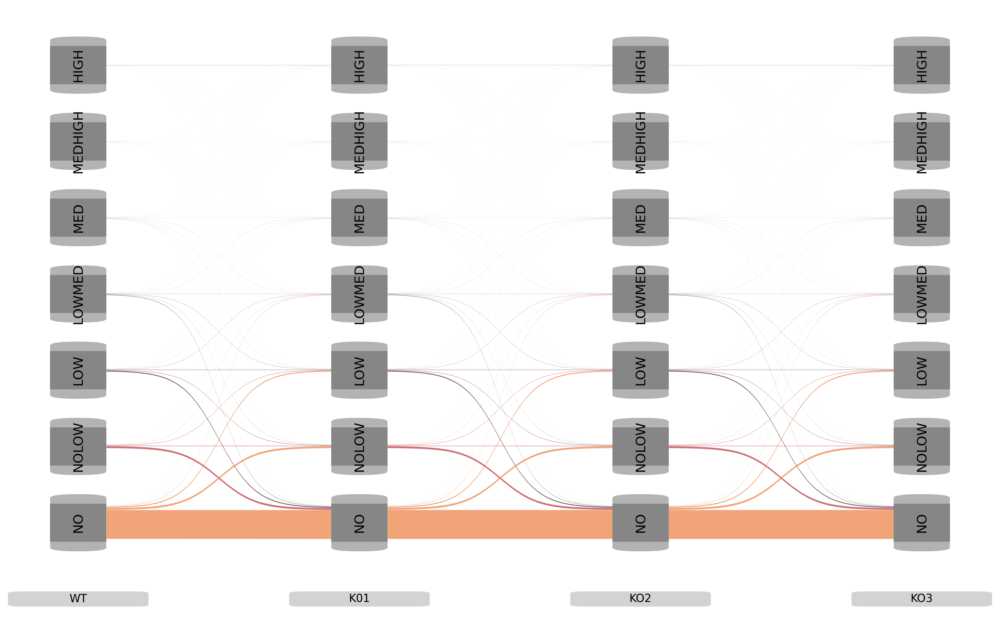

In [8]:
fa_triangular = FlowAnalysis(explDFWide, "gene", (("wildtype","WT"), ("knockout01","K01"),  ("knockout02","KO2"),  ("knockout03","KO3")), mfFuzzy) 
fa_triangular.plot_flows()

{'seriesOrder': ['cluster.wildtype', 'cluster.knockout01', 'cluster.knockout02', 'cluster.knockout03']}
-1.0 9.0
centers [0.1, 0.5, 0.9, 1.3, 1.7, 2.1, 2.5]
Creating Universe Range -1.0 -> 9.0 with step size 0.1
Mean Expr mean.cluster col 7
Expr Count expr.cluster col 12
SD sd.cluster col 8
Cluster cluster col 0
Combining over state:  False
to_homogeneous: knockout02
to_homogeneous: knockout01
to_homogeneous: knockout03
to_homogeneous: wildtype
shape: (15072, 29)
┌──────────┬────────────┬────────────┬────────────┬─────┬────────────┬────────────┬───────────┬────────────┐
│ gene     ┆ HIGH.knock ┆ LOW.knocko ┆ LOWMED.kno ┆ ... ┆ MED.wildty ┆ MEDHIGH.wi ┆ NO.wildty ┆ NOLOW.wild │
│ ---      ┆ out02      ┆ ut02       ┆ ckout02    ┆     ┆ pe         ┆ ldtype     ┆ pe        ┆ type       │
│ str      ┆ ---        ┆ ---        ┆ ---        ┆     ┆ ---        ┆ ---        ┆ ---       ┆ ---        │
│          ┆ f64        ┆ f64        ┆ f64        ┆     ┆ f64        ┆ f64        ┆ f64       ┆ 

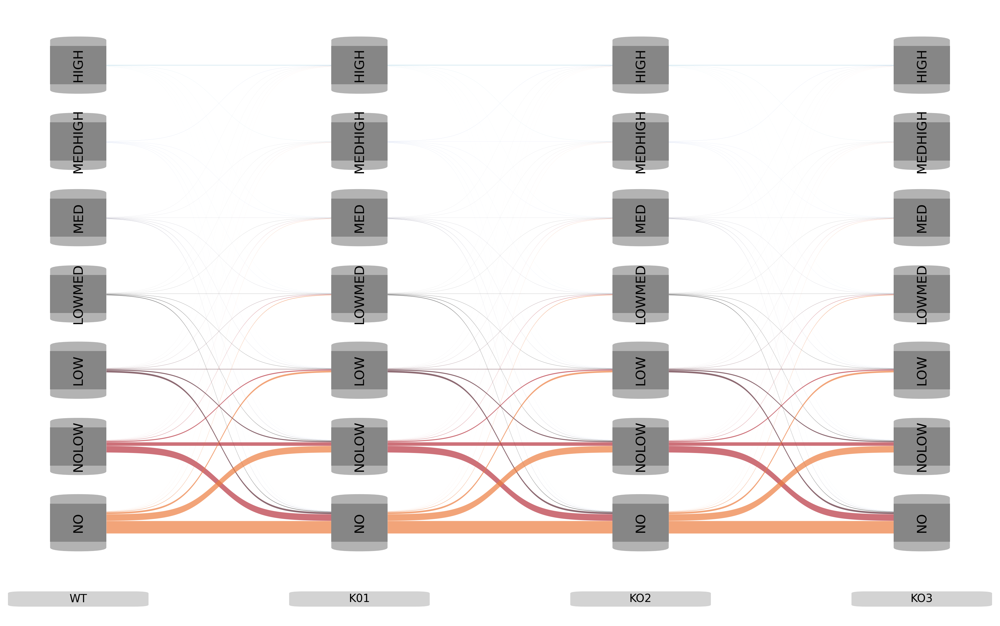

In [9]:

explDFRaw, mfFuzzy = FlowAnalysis.exprDF2LongDF(exprData, stepsize=0.1,seriesOrder=["cluster.wildtype", "cluster.knockout01", "cluster.knockout02", "cluster.knockout03"],mfLevels = ["NO","NOLOW","LOW","LOWMED","MED","MEDHIGH","HIGH"],centers=[.1,.5,.9,1.3,1.7,2.1,2.5],shape="gauss")
explDFWide = FlowAnalysis.to_vwide(explDFRaw, mfFuzzy)
print(explDFWide)
fa_gaussian = FlowAnalysis(explDFWide, "gene",(("wildtype","WT"),  ("knockout01","K01"),  ("knockout02","KO2"),  ("knockout03","KO3")), mfFuzzy) 
fa_gaussian.plot_flows()


{'seriesOrder': ['cluster.wildtype', 'cluster.knockout01', 'cluster.knockout02', 'cluster.knockout03']}
-1.0 9.0
centers [0.1, 0.5, 0.9, 1.3, 1.7, 2.1, 2.5]
Creating Universe Range -1.0 -> 9.0 with step size 0.1
Mean Expr mean.cluster col 7
Expr Count expr.cluster col 12
SD None col None
Cluster cluster col 0
Combining over state:  False
Crisp mode, different assignment
Crisp mode, different assignment
Crisp mode, different assignment
Crisp mode, different assignment
to_homogeneous: knockout02
to_homogeneous: knockout01
to_homogeneous: knockout03
to_homogeneous: wildtype
shape: (15072, 29)
┌──────────┬────────────┬────────────┬────────────┬─────┬────────────┬────────────┬───────────┬────────────┐
│ gene     ┆ HIGH.knock ┆ LOW.knocko ┆ LOWMED.kno ┆ ... ┆ MED.wildty ┆ MEDHIGH.wi ┆ NO.wildty ┆ NOLOW.wild │
│ ---      ┆ out02      ┆ ut02       ┆ ckout02    ┆     ┆ pe         ┆ ldtype     ┆ pe        ┆ type       │
│ str      ┆ ---        ┆ ---        ┆ ---        ┆     ┆ ---        ┆ ---  

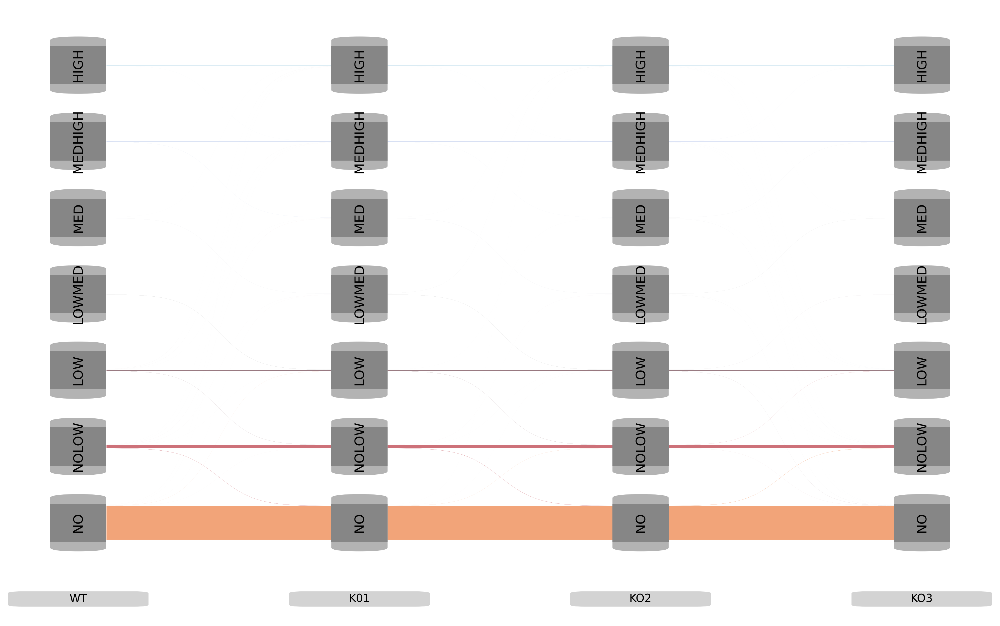

In [10]:
explDFRaw, mfFuzzy = FlowAnalysis.exprDF2LongDF(exprData, stepsize=0.1,seriesOrder=["cluster.wildtype", "cluster.knockout01", "cluster.knockout02", "cluster.knockout03"],mfLevels = ["NO","NOLOW","LOW","LOWMED","MED","MEDHIGH","HIGH"],centers=[.1,.5,.9,1.3,1.7,2.1,2.5], sdcolName=None, shape="crisp")
explDFWide = FlowAnalysis.to_vwide(explDFRaw, mfFuzzy)
print(explDFWide)
fa_crisp = FlowAnalysis(explDFWide, "gene",(("wildtype","WT"),  ("knockout01","K01"),  ("knockout02","KO2"),  ("knockout03","KO3")), mfFuzzy) 
fa_crisp.plot_flows()


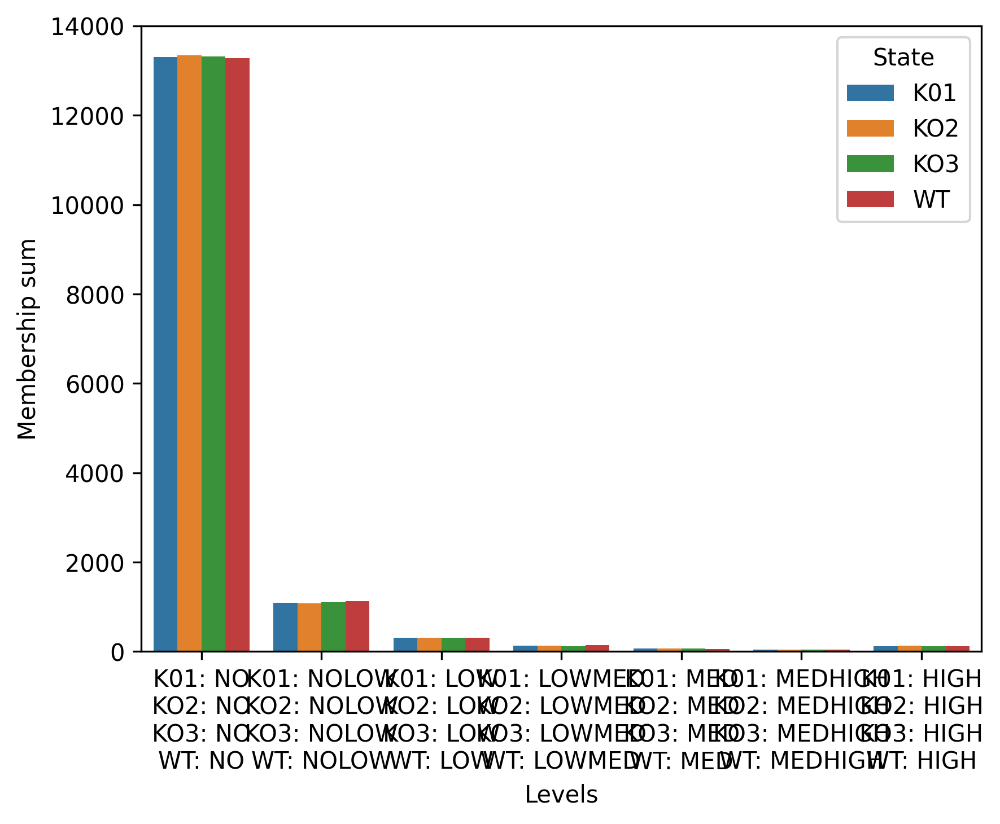

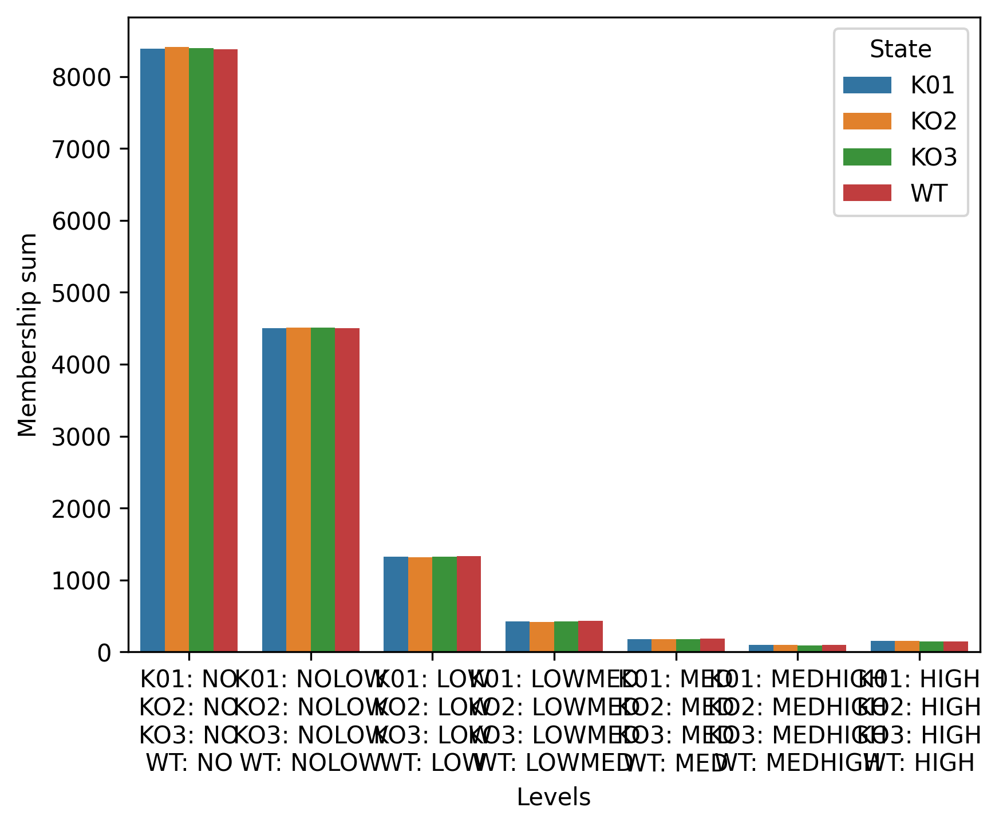

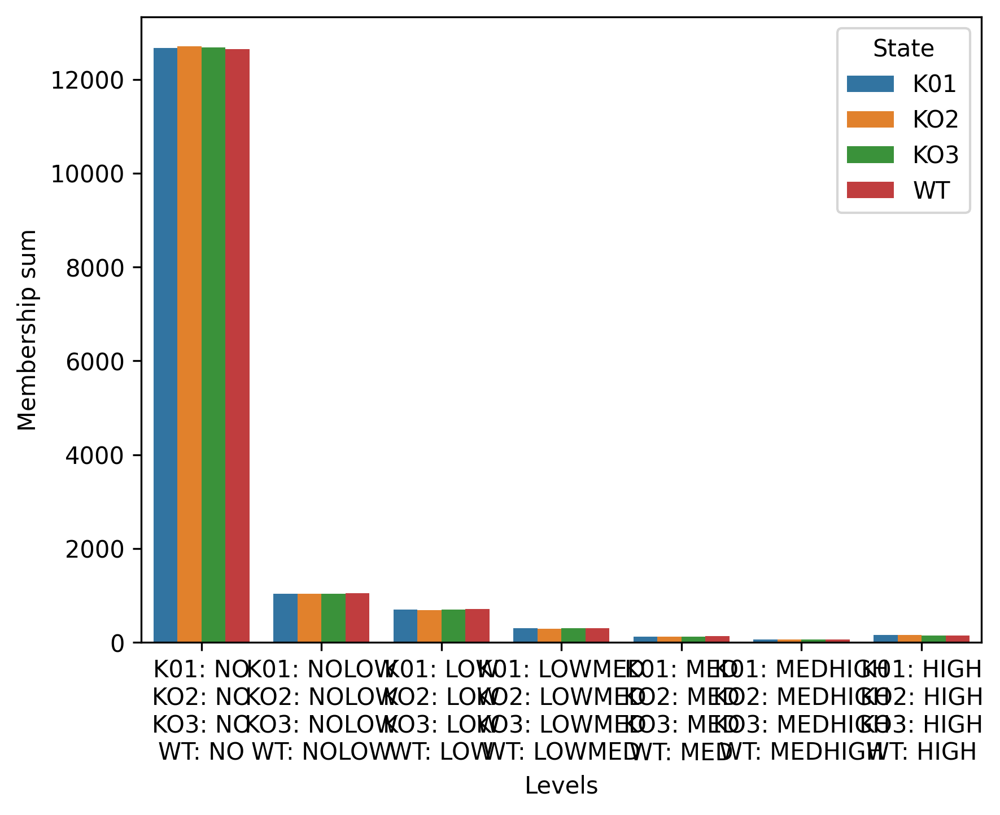

In [11]:

fa_crisp.hist_level_membershipsum()
fa_gaussian.hist_level_membershipsum()
fa_triangular.hist_level_membershipsum()


In [12]:
pw_file="go_human_filtered.bp.gmt"
rp = fa_crisp.get_pathways(pw_file)


Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways


In [13]:
alteredPathways=pd.read_csv('simulated_changingPathways_random.tsv',sep='\t')

pattern_groups=dict()
for pattern in alteredPathways[alteredPathways.duplicated() == False].iterrows():
    strpattern = '-'.join(pattern[-1].astype(str))
    pattern_groups[strpattern]=alteredPathways[[x[-1].equals(pattern[-1]) for x in alteredPathways.iterrows()]].index

pattern_groups

{'1-1-4-4': Index(['endoplasmic reticulum-plasma membrane tethering',
        'nucleotide-binding oligomerization domain containing 2 signaling pathway',
        'lysine catabolic process',
        'positive regulation of T cell activation via T cell receptor contact with antigen bound to MHC molecule on antigen presenting cell',
        'wound healing involved in inflammatory response',
        'nucleotide-binding oligomerization domain containing 1 signaling pathway',
        'positive regulation of nucleotide-binding oligomerization domain containing 1 signaling pathway',
        'proteasome regulatory particle assembly',
        'negative regulation of apoptotic DNA fragmentation',
        'regulation of protein autophosphorylation'],
       dtype='object'),
 '1-8-8-1': Index(['catabolic process', 'isoprenoid metabolic process',
        'zinc ion homeostasis', 'amino acid catabolic process',
        'negative regulation of myosin-light-chain-phosphatase activity',
        'negative

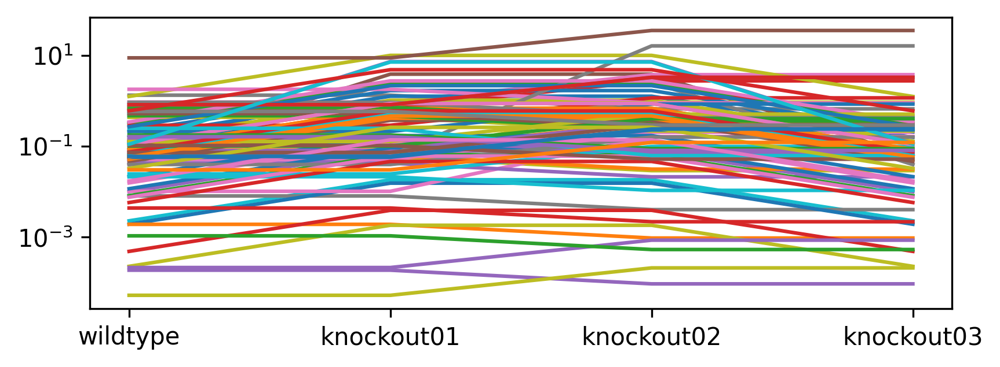

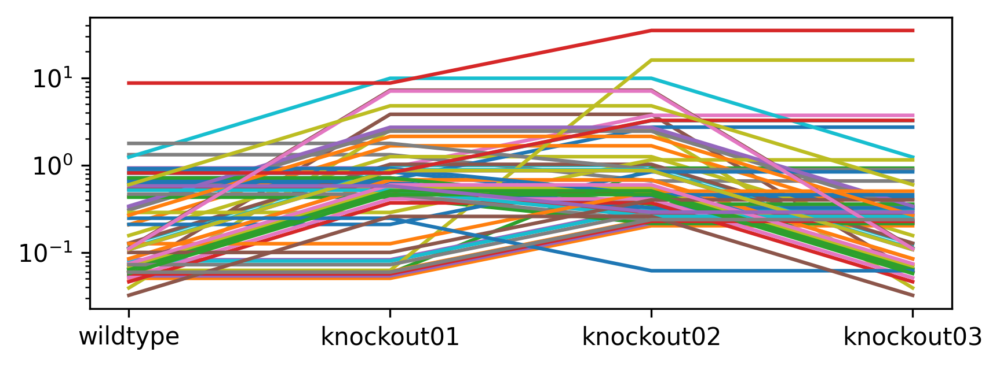

In [14]:
changed_genes= pd.read_csv("./simulated_changingGenes_random.tsv",sep="\t")

fig = plt.figure() 
ax = fig.add_subplot(2, 1, 1) 
for index, row in changed_genes.iterrows(): 
    plt.plot(row,label=index)

ax.set_yscale('log')

changed_genes=changed_genes[changed_genes.max(axis=1)>0.2] 

fig = plt.figure() 
ax = fig.add_subplot(2, 1, 1) 
for index, row in changed_genes.iterrows(): 
    plt.plot(row,label=index)

ax.set_yscale('log')

changed_genes_list=set(changed_genes.index)


# Basic overview over the memberships of the altered genes in the differnt states and models

['CD81', 'ESYT2', 'ESYT1', 'NFKBIA', 'PSMD10', 'SLC46A2', 'TLR4', 'AASS', 'PSMD5', 'EEF2K', 'VAPB', 'CRYM', 'DFFB', 'PPP2R5B', 'PSMD9', 'HMOX1', 'NOD2', 'HYKK', 'LACC1', 'MOB1B', 'IRGM', 'LGALS9', 'DFFA']


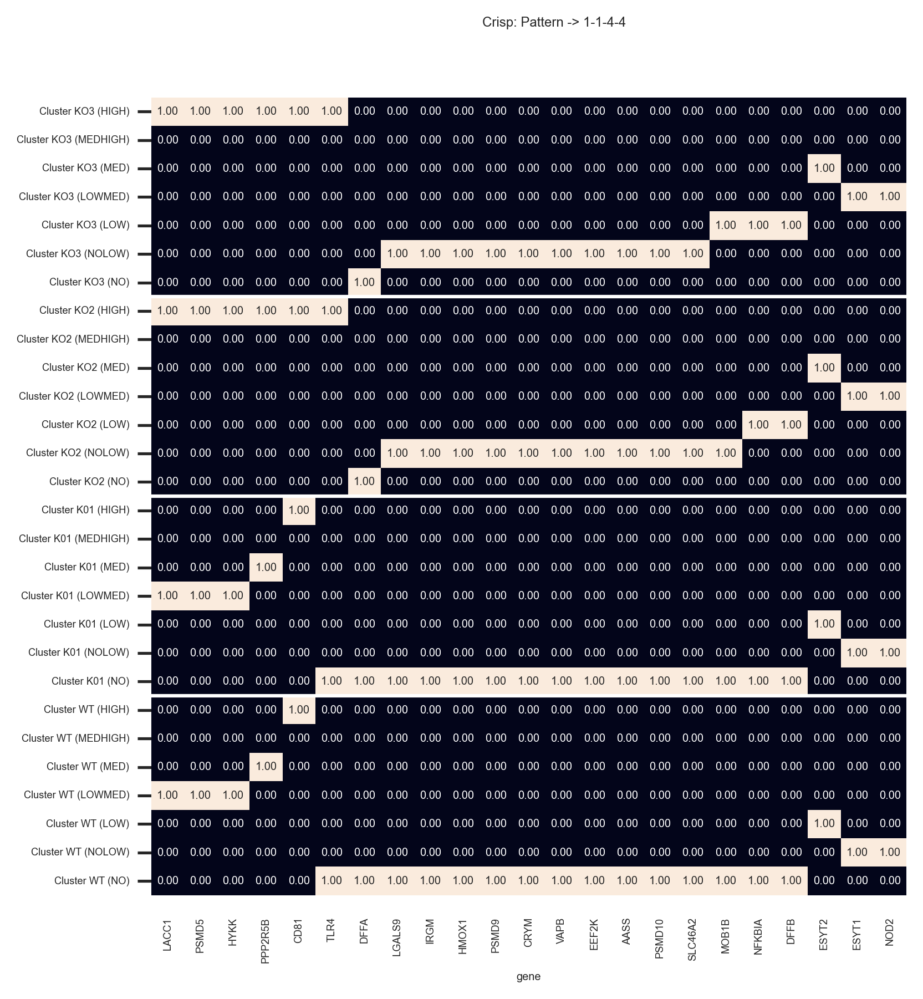

Creating FlowIDs


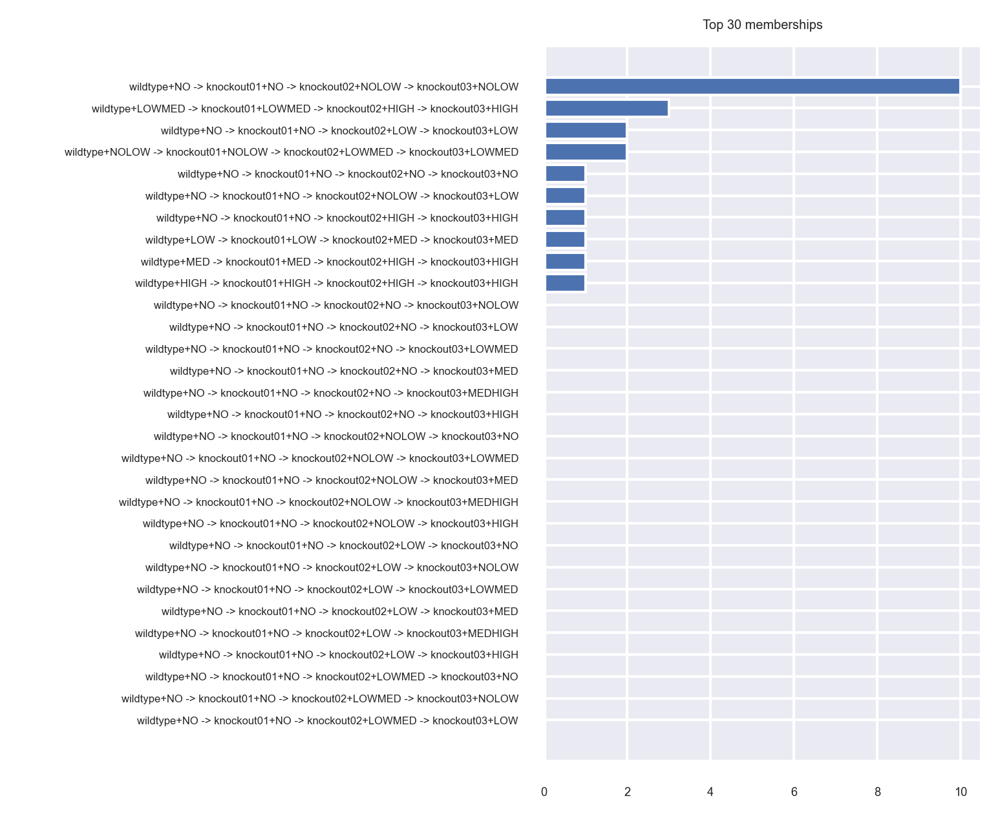

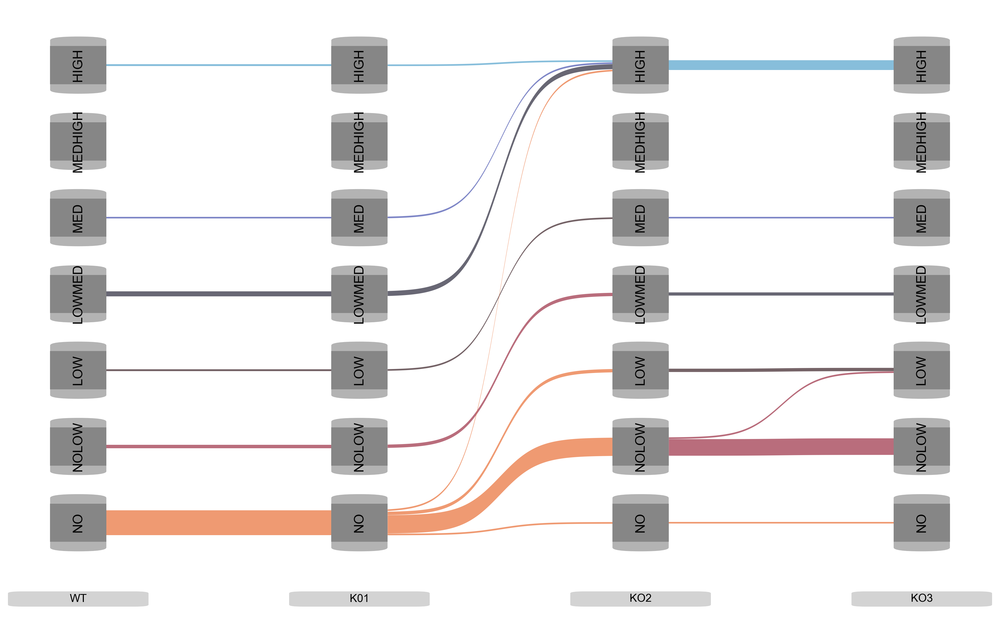

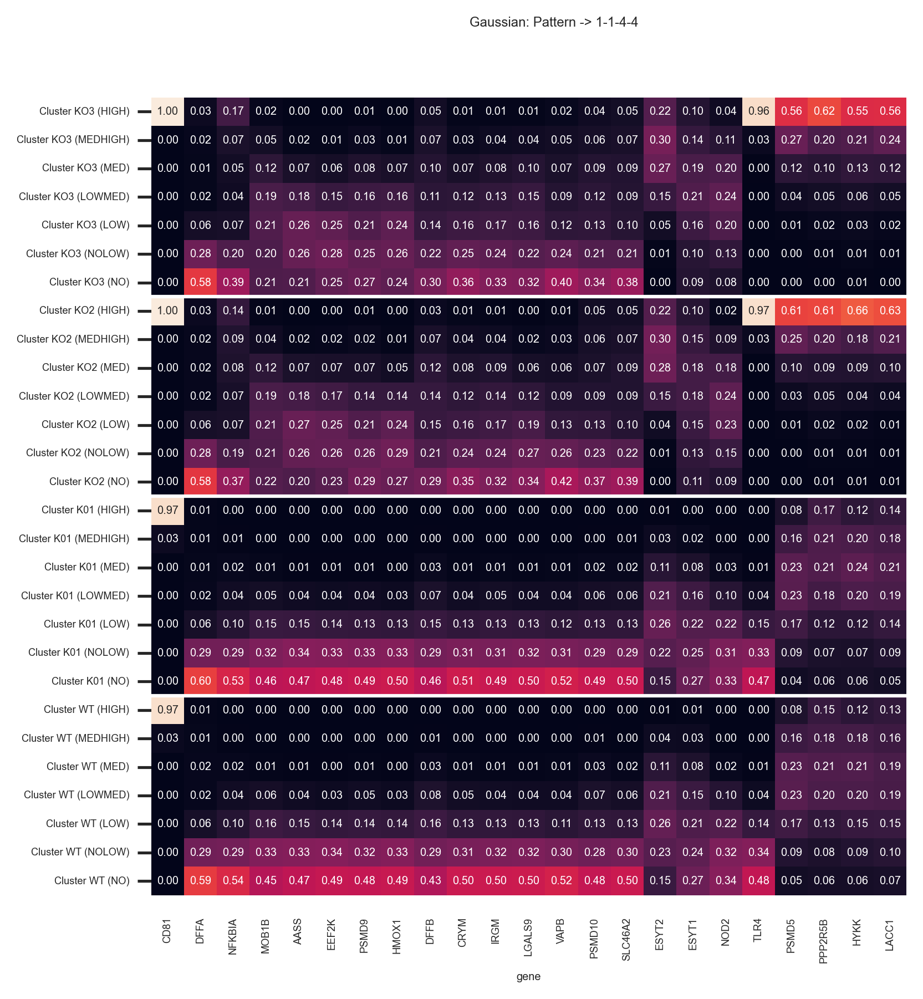

Creating FlowIDs


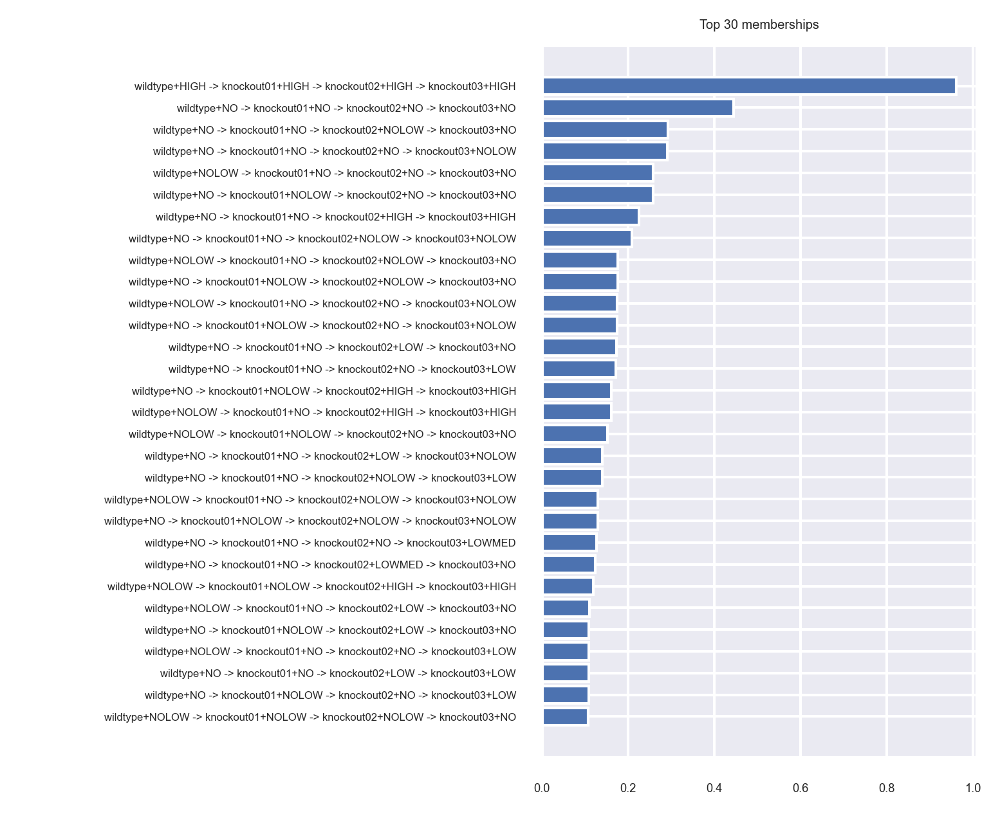

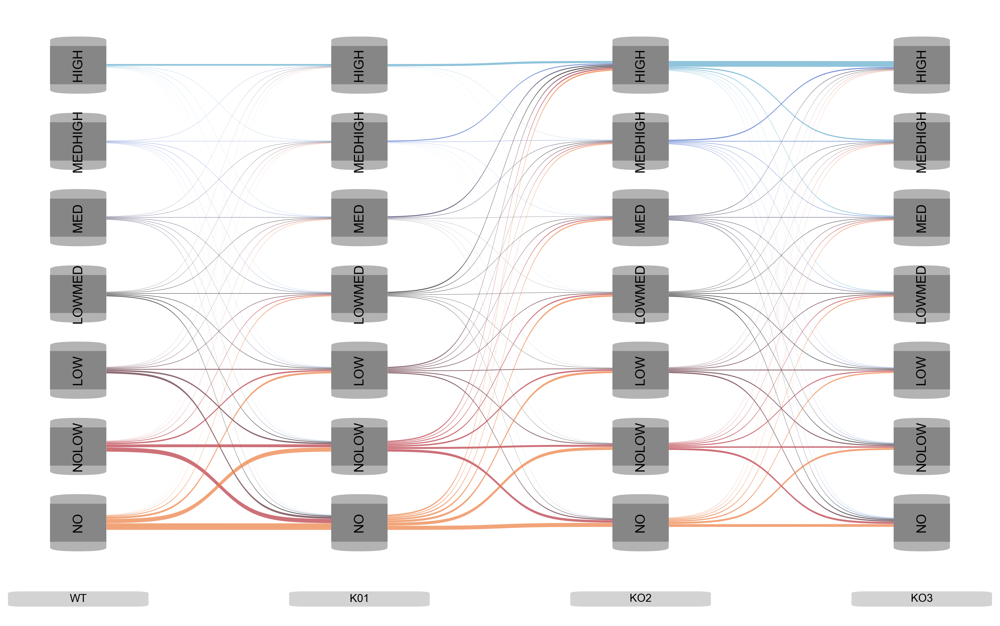

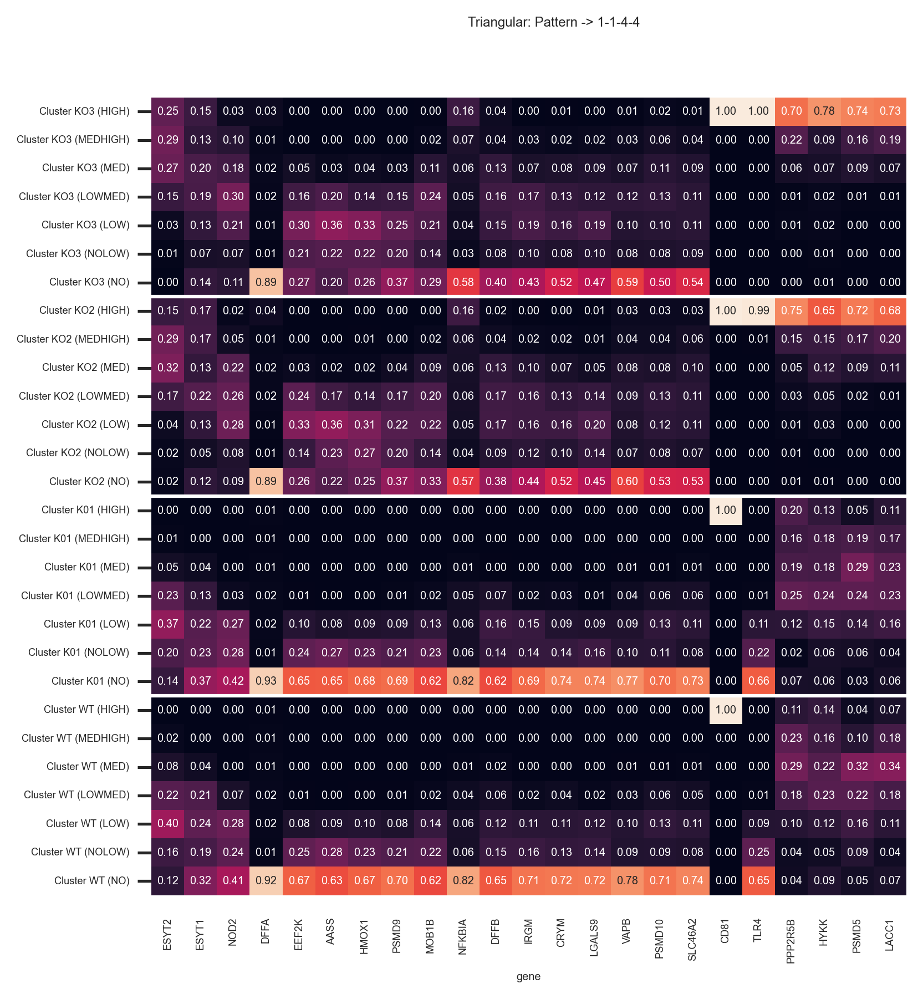

Creating FlowIDs


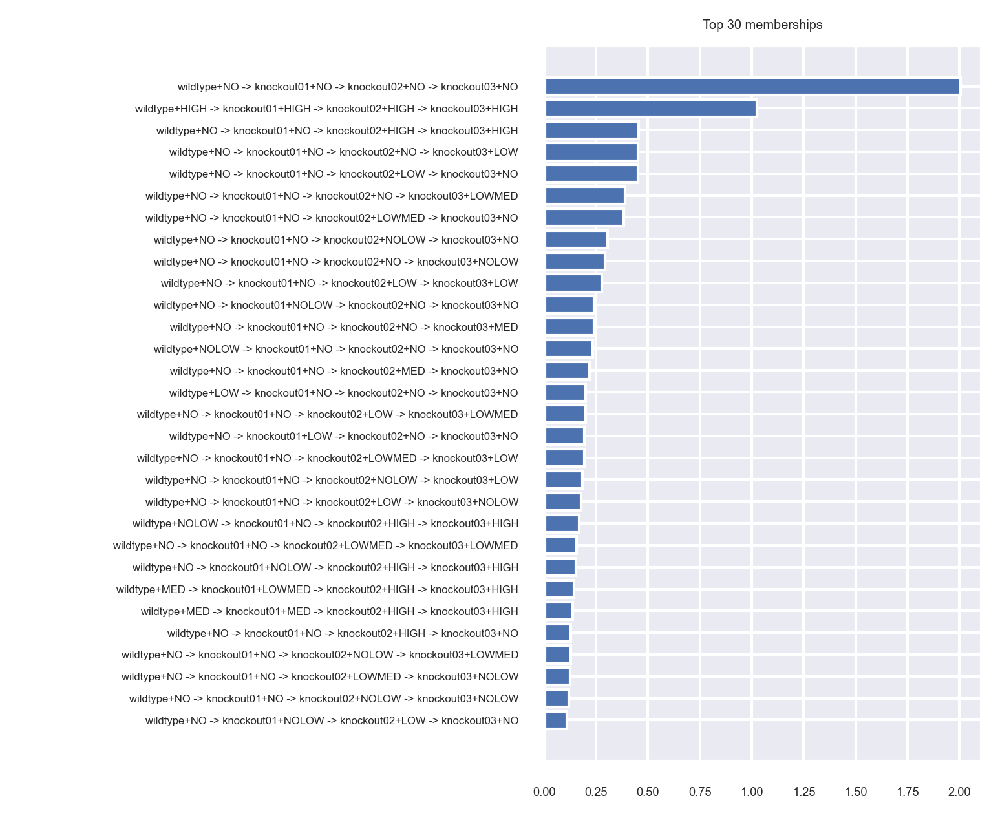

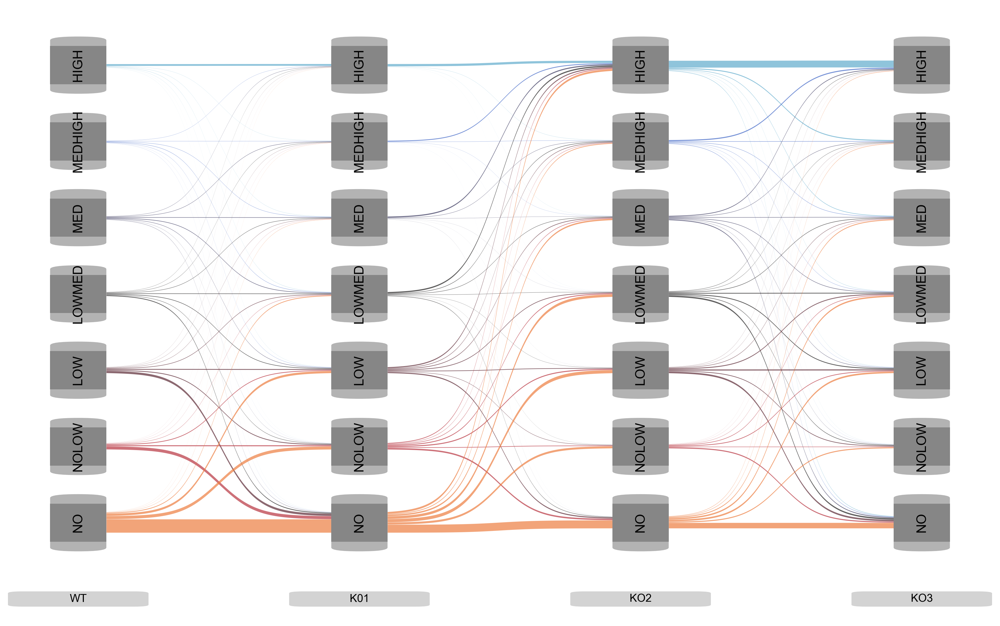

['ZC3H12A', 'ATF5', 'ETFA', 'SLC30A4', 'TMEM150A', 'AURKA', 'PHYH', 'WDR62', 'FNBP1L', 'CES2', 'MARK4', 'ROCK2', 'GATD1', 'ROCK1', 'TNF', 'GGPS1', 'RC3H2', 'MCPH1', 'CHMP4A', 'IKBKB', 'FOXP3', 'IL4I1', 'RC3H1', 'ETFB', 'ZBTB7B', 'PARK7', 'HGS', 'CCNL2', 'SNX3', 'PRKN']


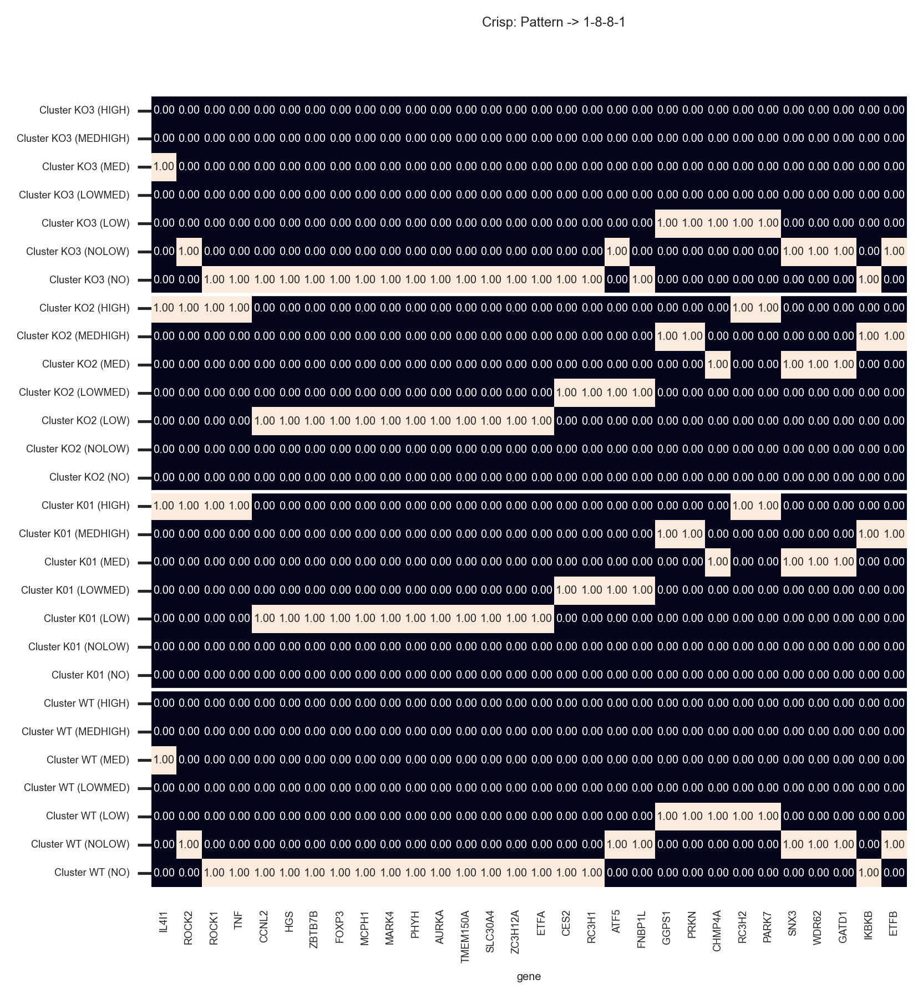

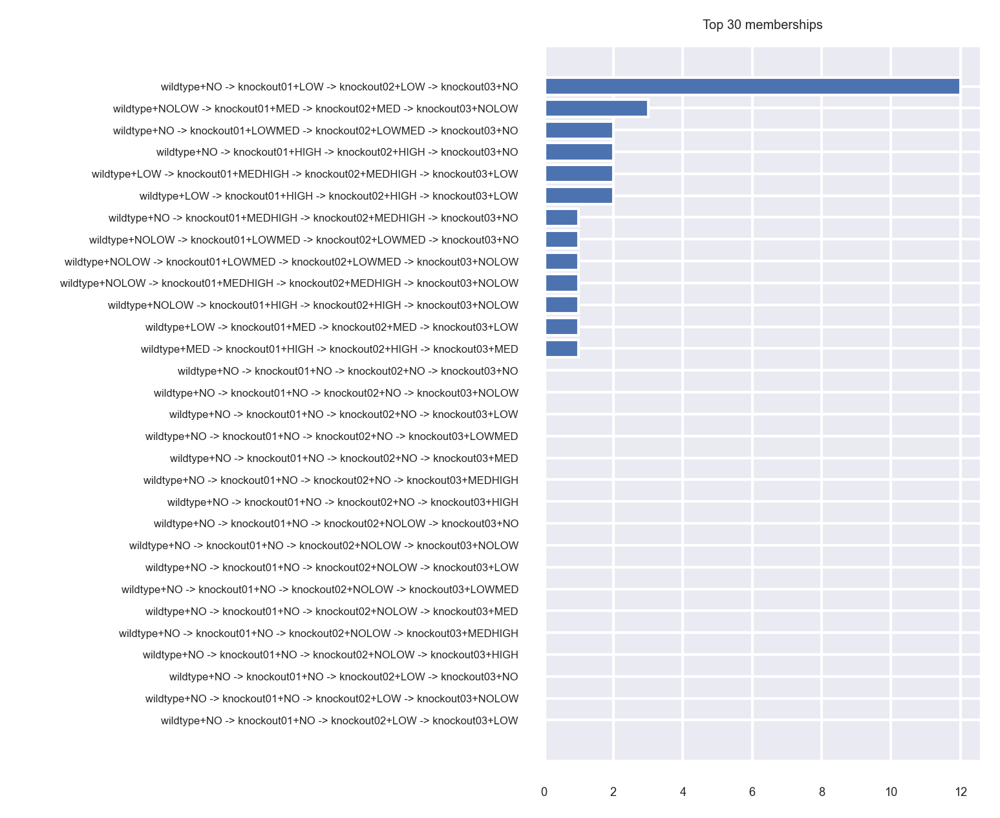

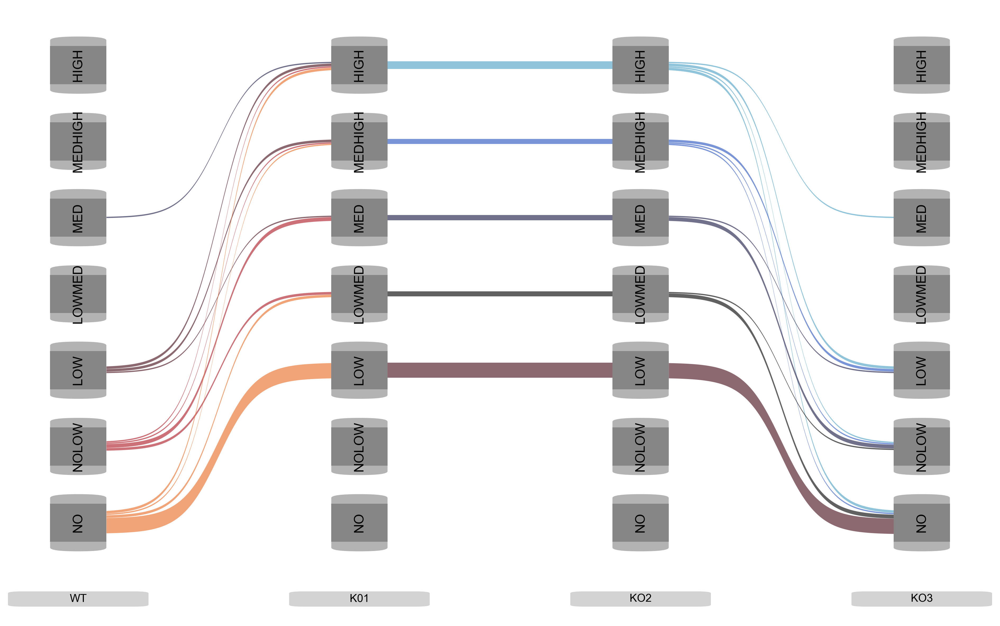

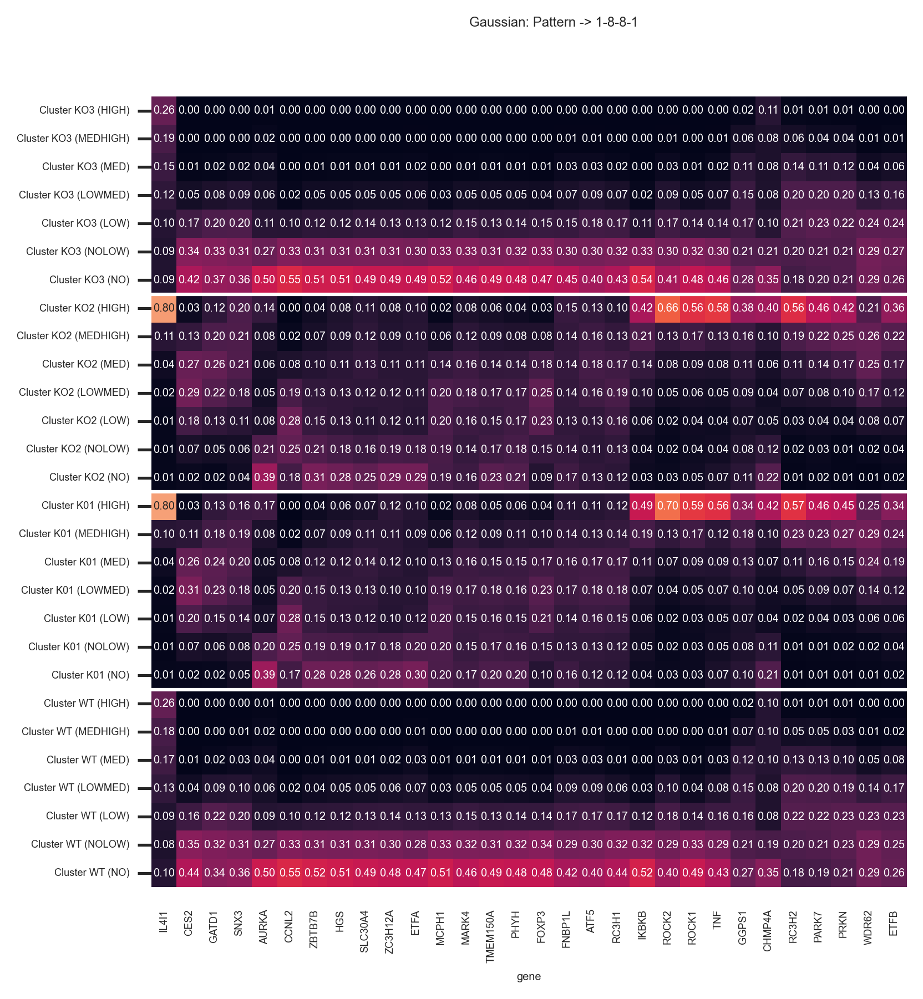

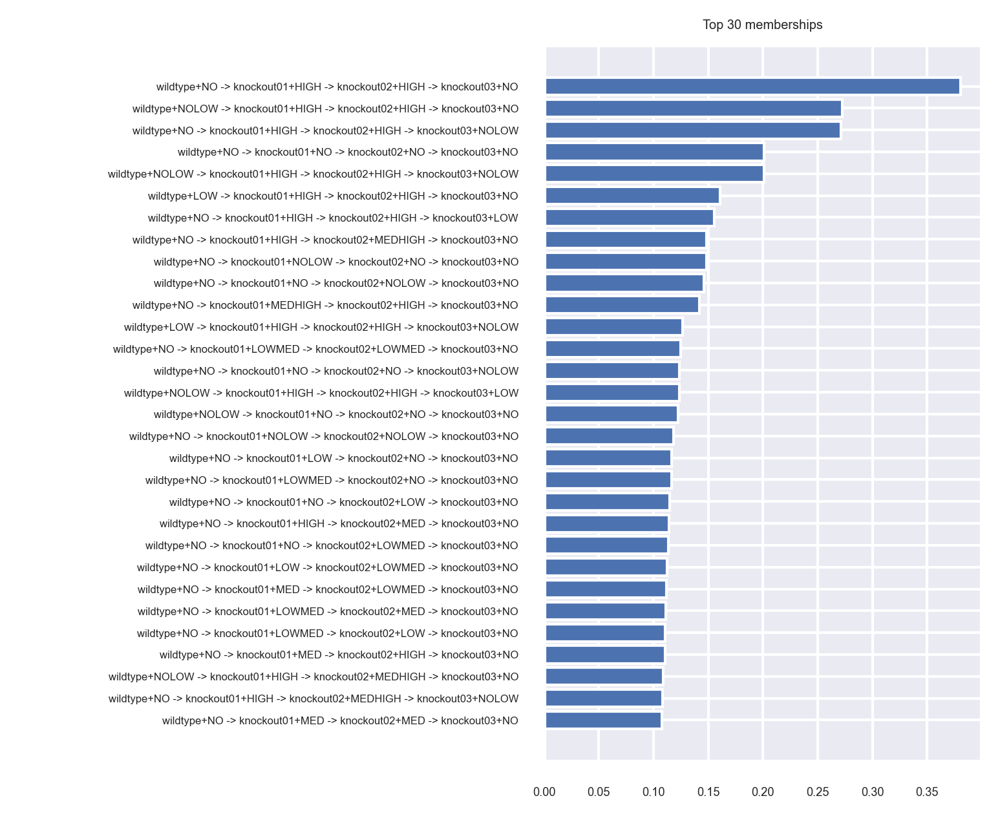

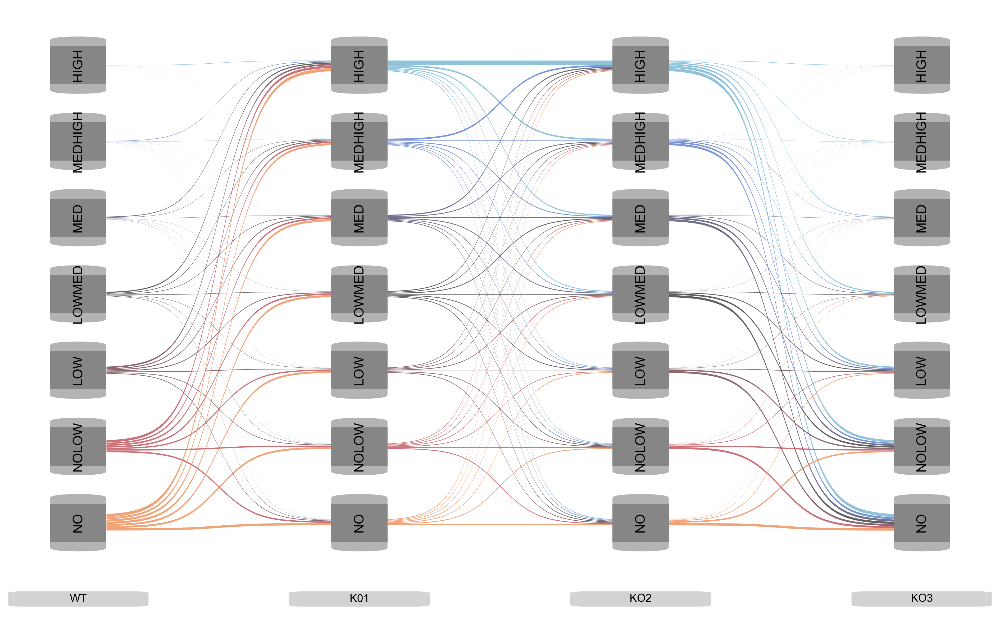

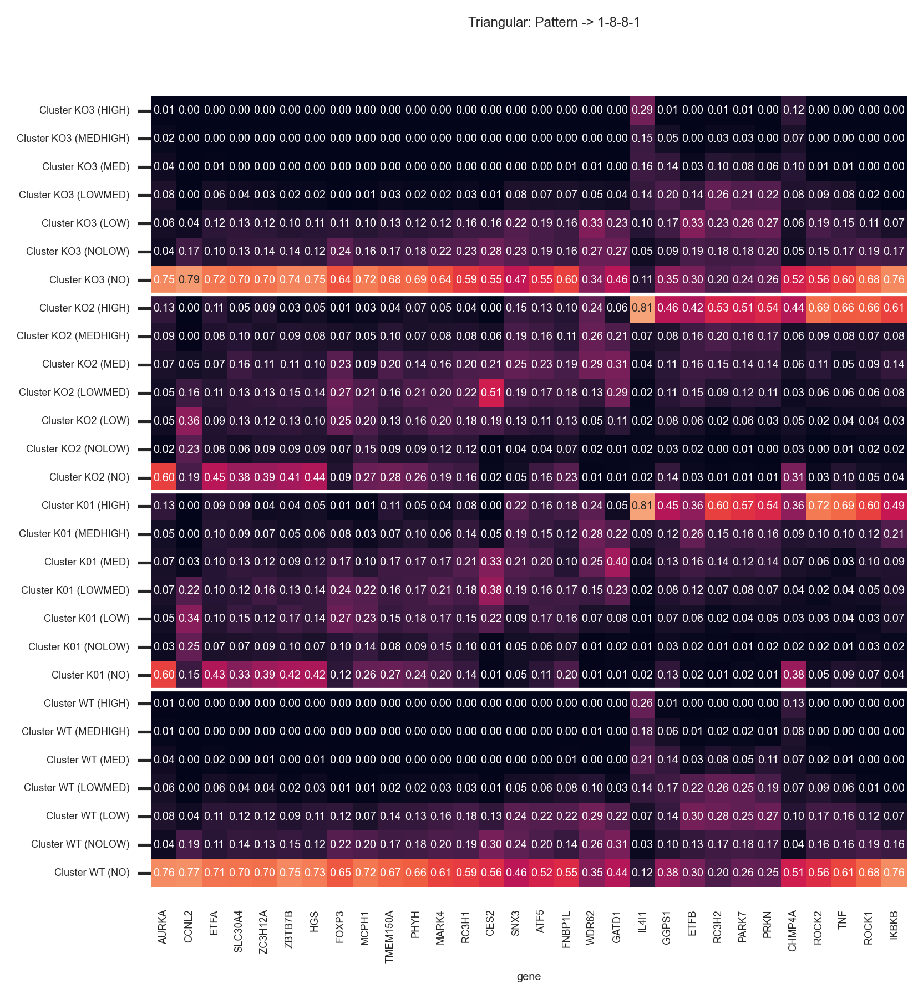

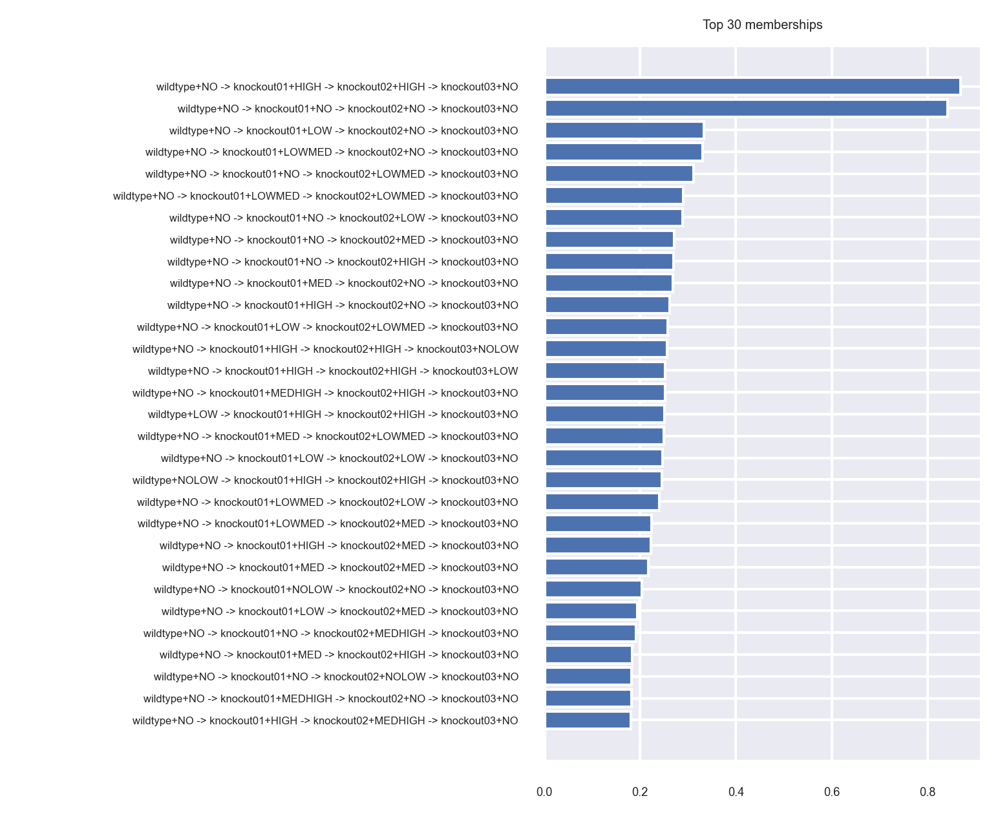

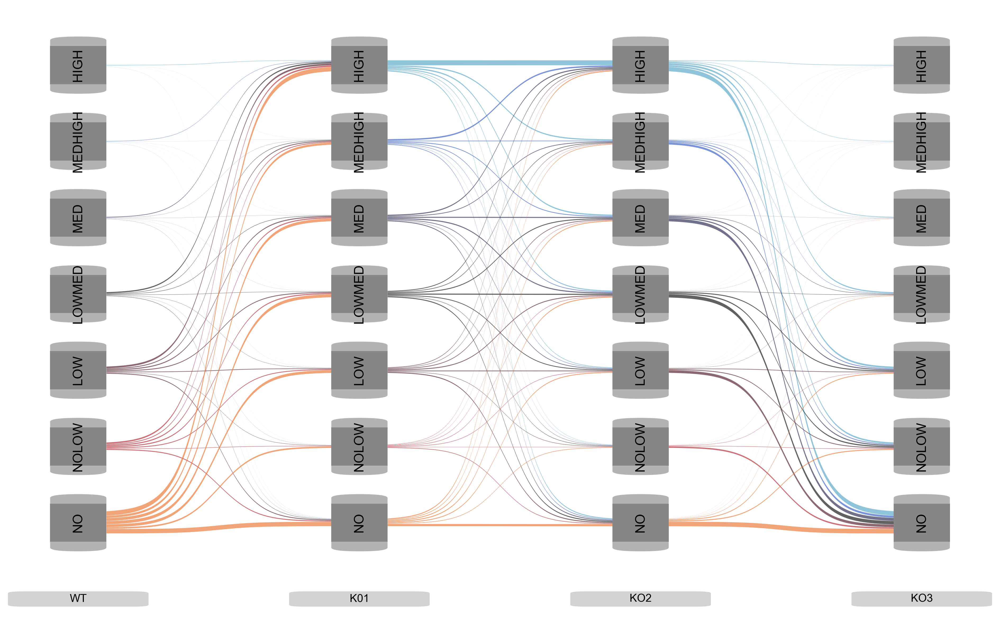

['ABCC4', 'STXBP1', 'GJB6', 'KDM1A', 'SMAD3', 'GFI1', 'PLXNA4', 'TBX1', 'TPH1', 'NIPBL', 'SAMD1', 'RAD1', 'RORA', 'EIF3G', 'SGTA', 'USP14']


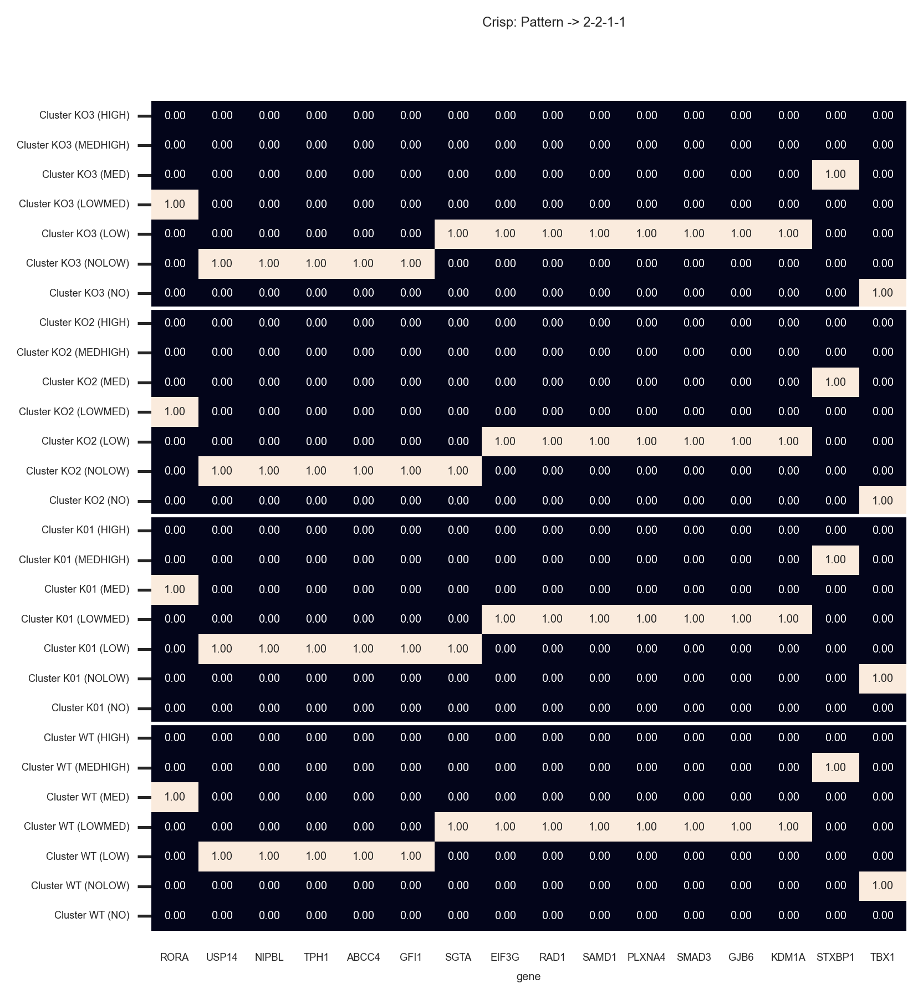

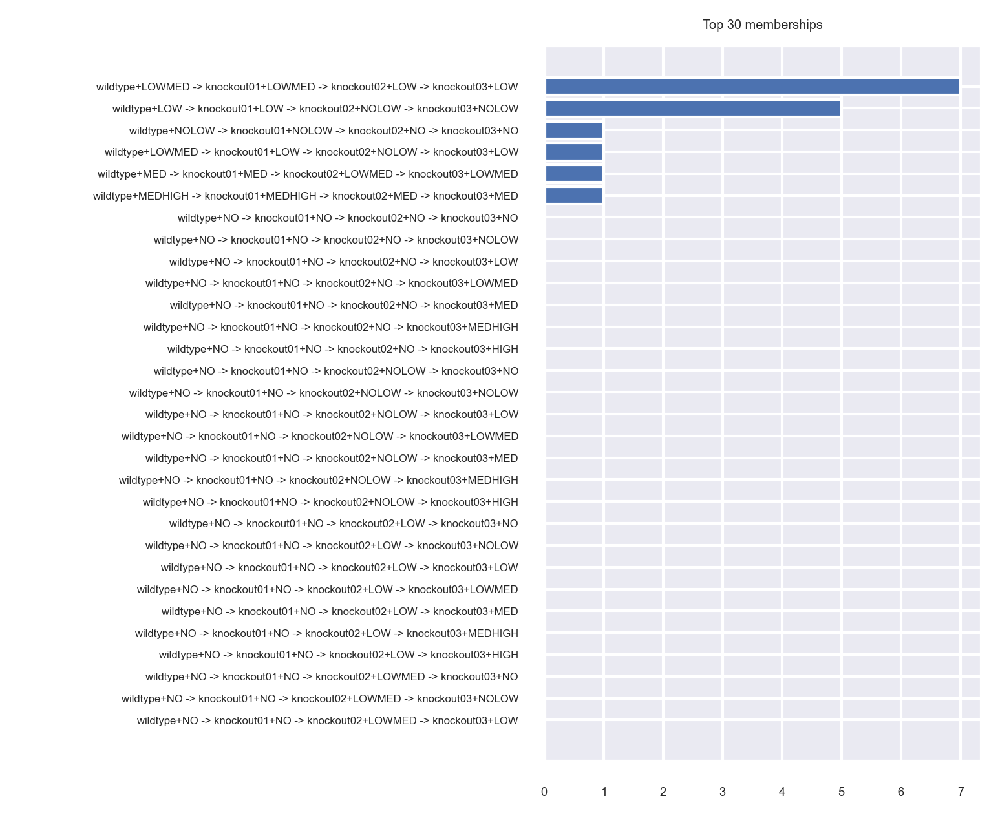

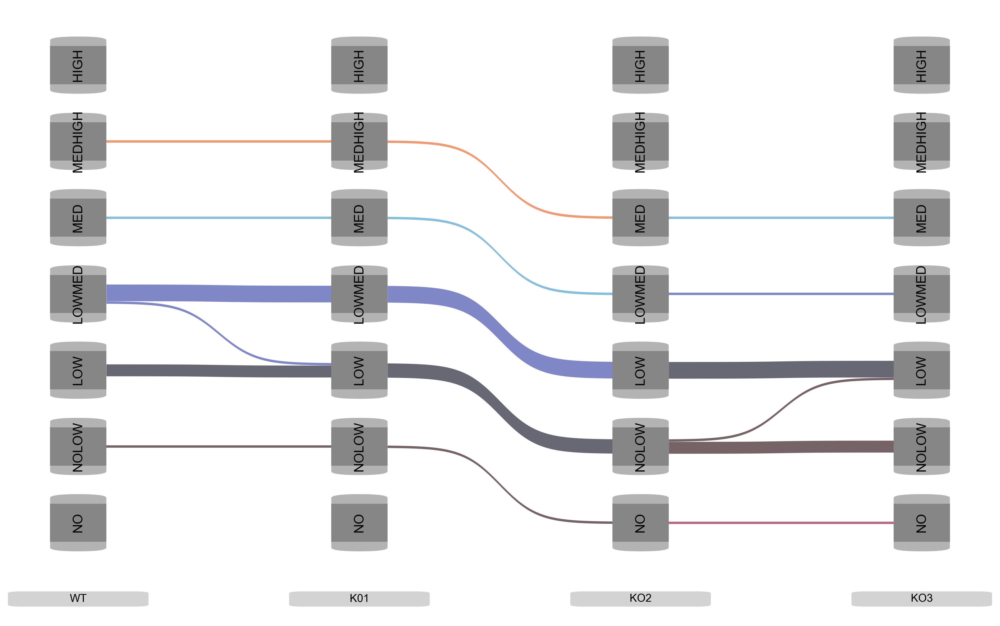

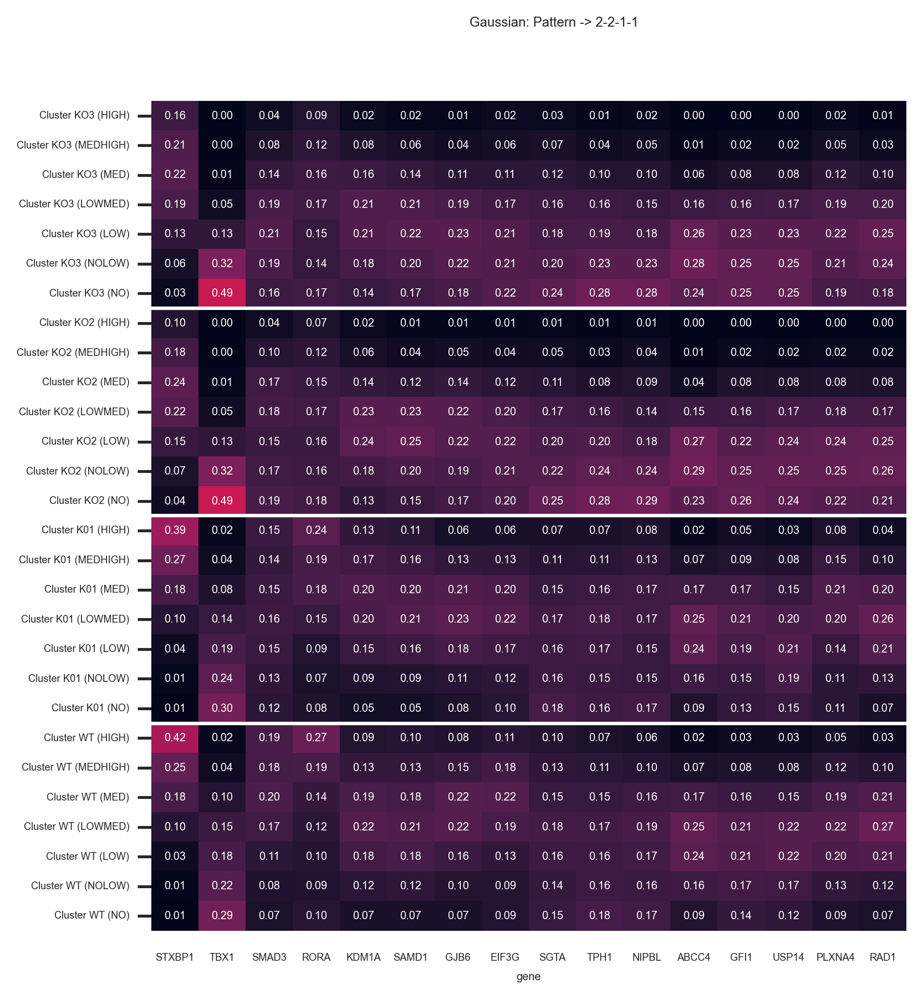

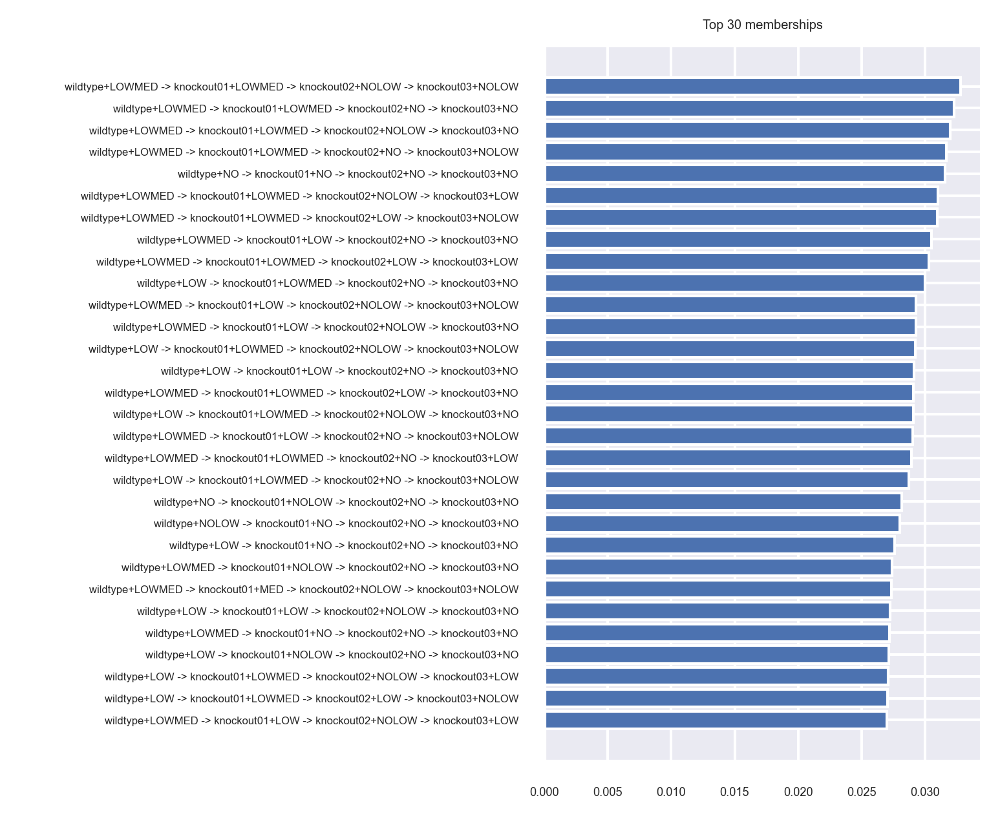

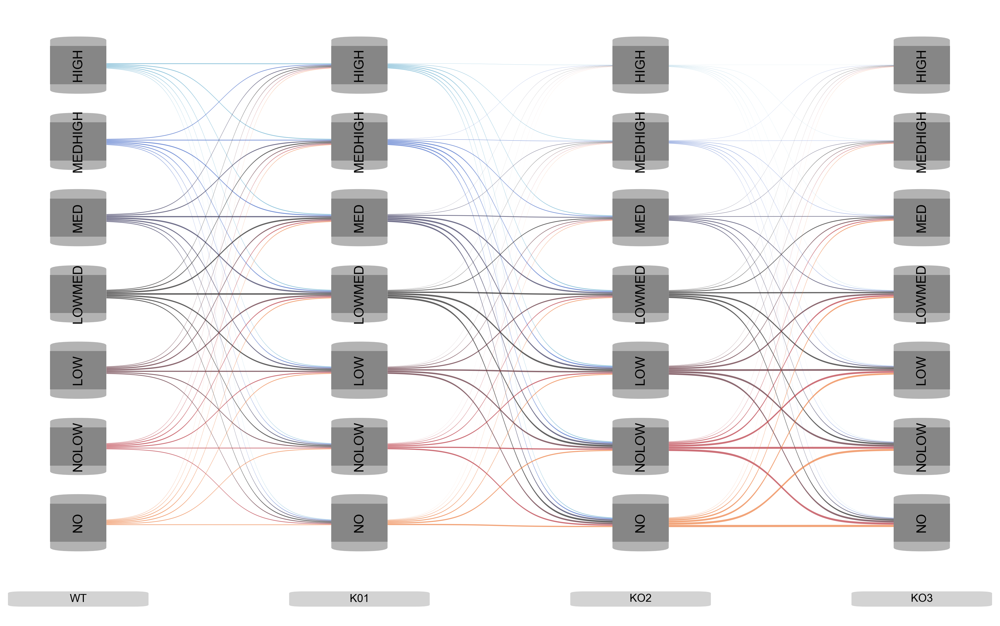

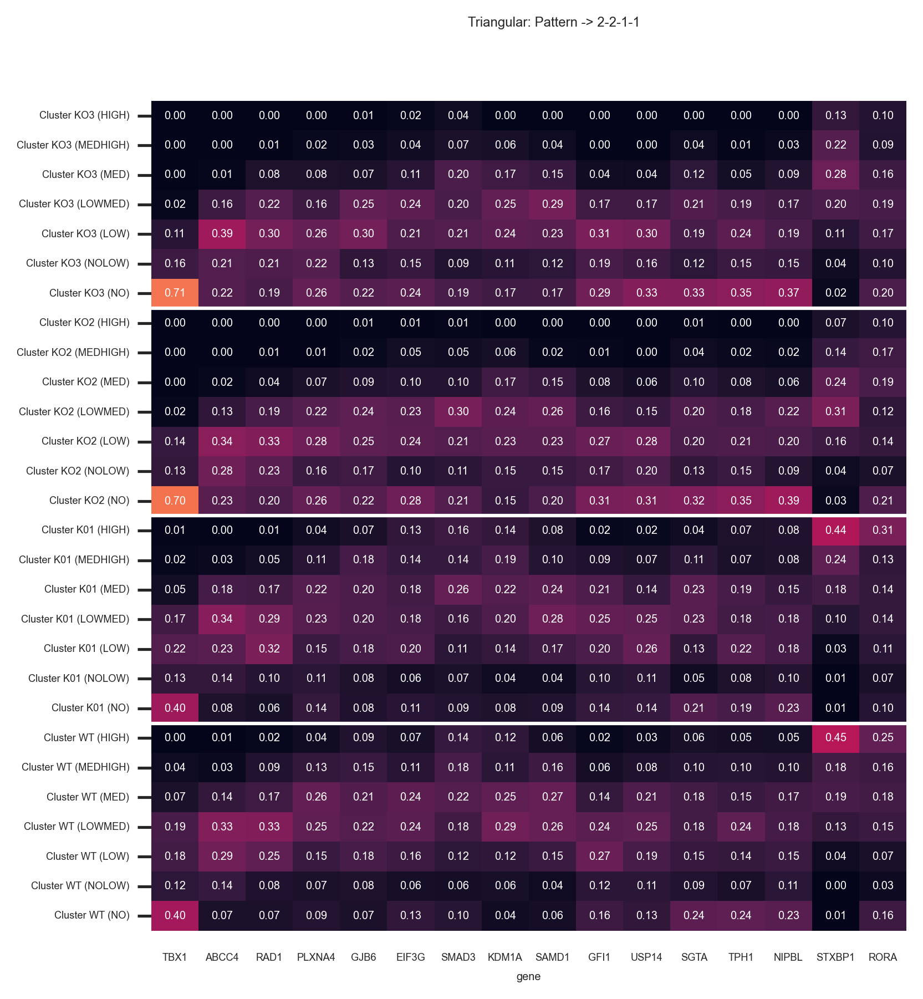

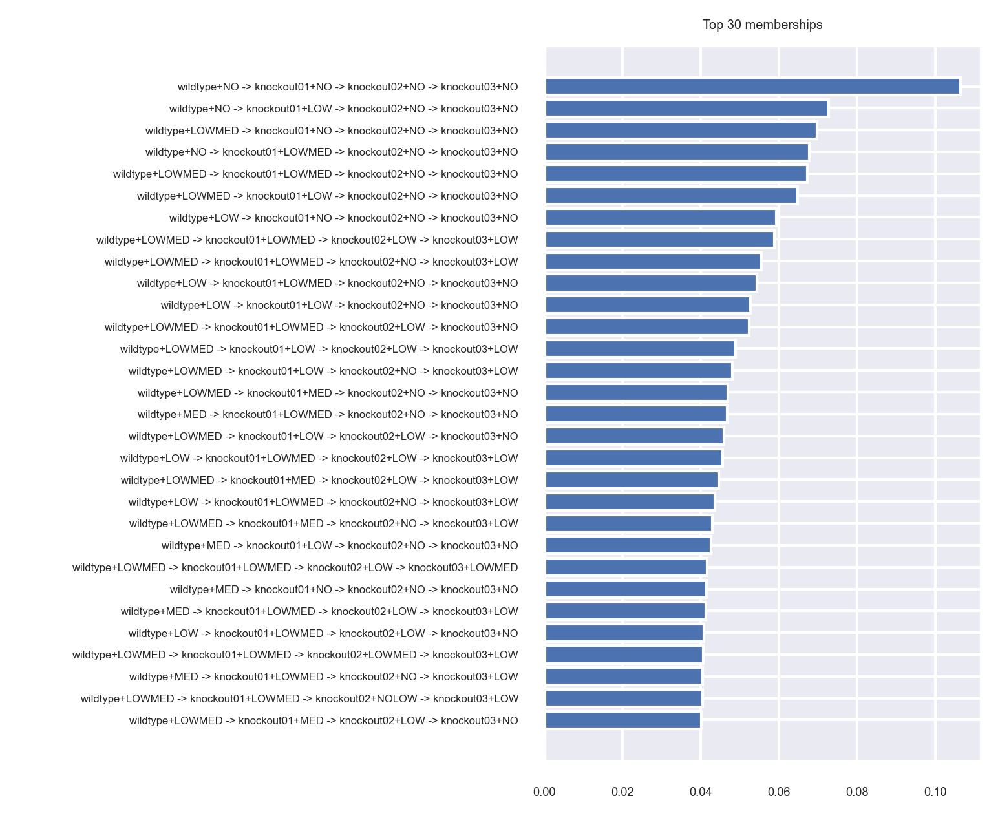

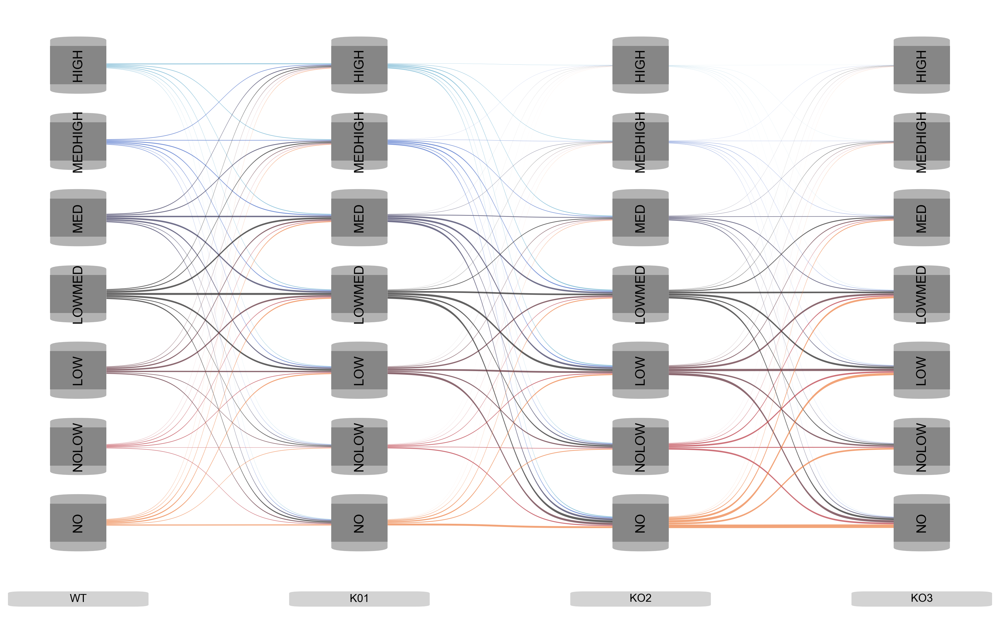

In [15]:

pwnames=[rp[x][0] for x in rp]

for key, value in pattern_groups.items():
    union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
    union_geneset = [item for sublist in union_geneset for item in sublist]
    union_geneset=list(set(union_geneset).intersection(changed_genes_list))

    print(union_geneset)

    fa_crisp.plot_state_memberships(union_geneset,"Crisp: Pattern -> "+key,cluster_genes=True)
    fa_crisp.plot_genes_membership(union_geneset)
    fa_crisp.plot_flows(genes=union_geneset,min_flow=.010)


    fa_gaussian.plot_state_memberships(union_geneset,"Gaussian: Pattern -> "+key,cluster_genes=True)
    fa_gaussian.plot_genes_membership(union_geneset)
    fa_gaussian.plot_flows(genes=union_geneset,min_flow=.010)

    fa_triangular.plot_state_memberships(union_geneset,"Triangular: Pattern -> "+key,cluster_genes=True)
    fa_triangular.plot_genes_membership(union_geneset)
    fa_triangular.plot_flows(genes=union_geneset,min_flow=.01)




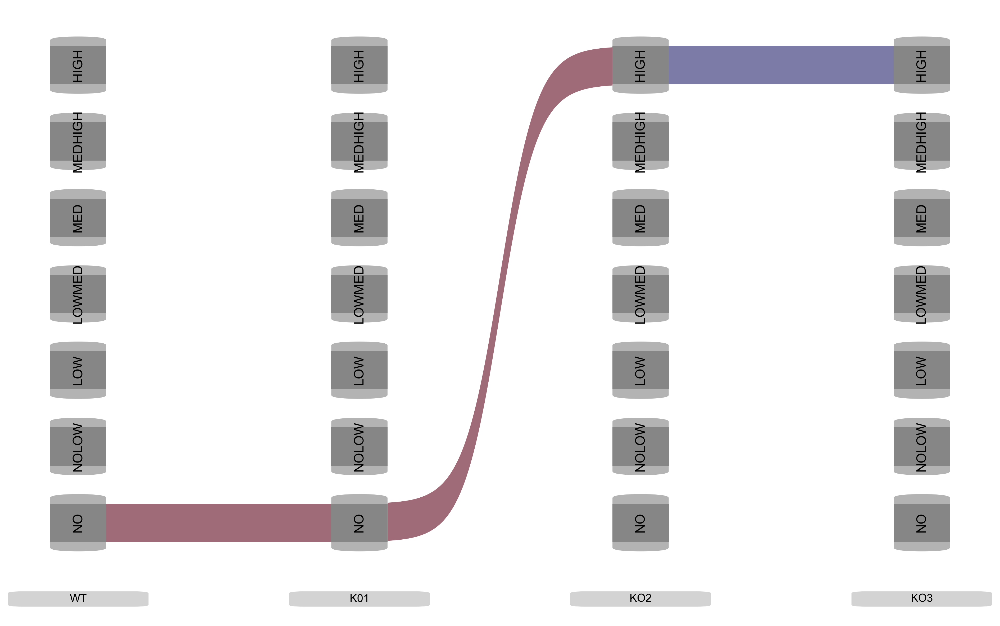

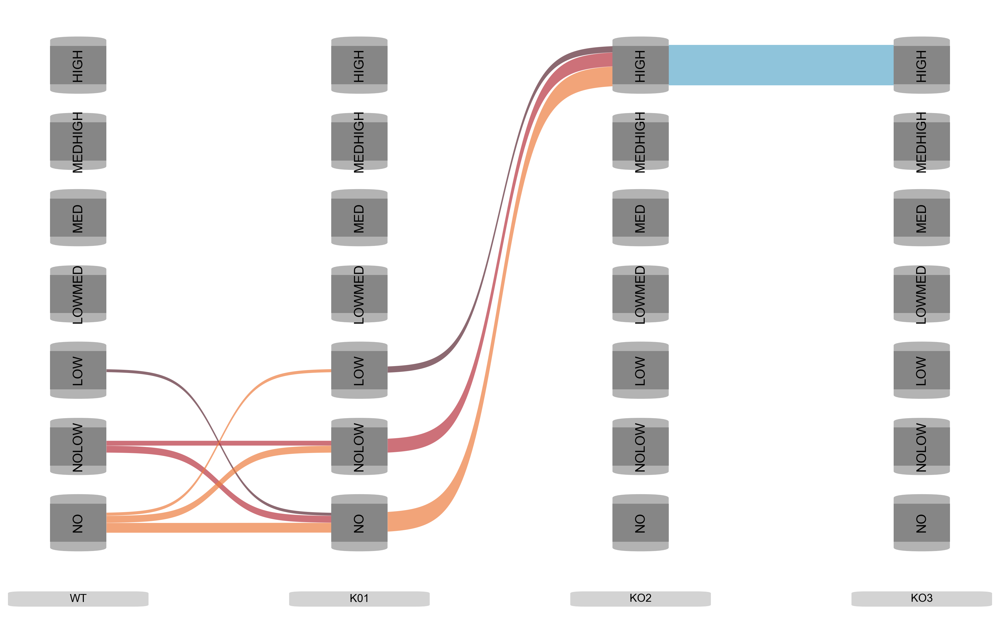

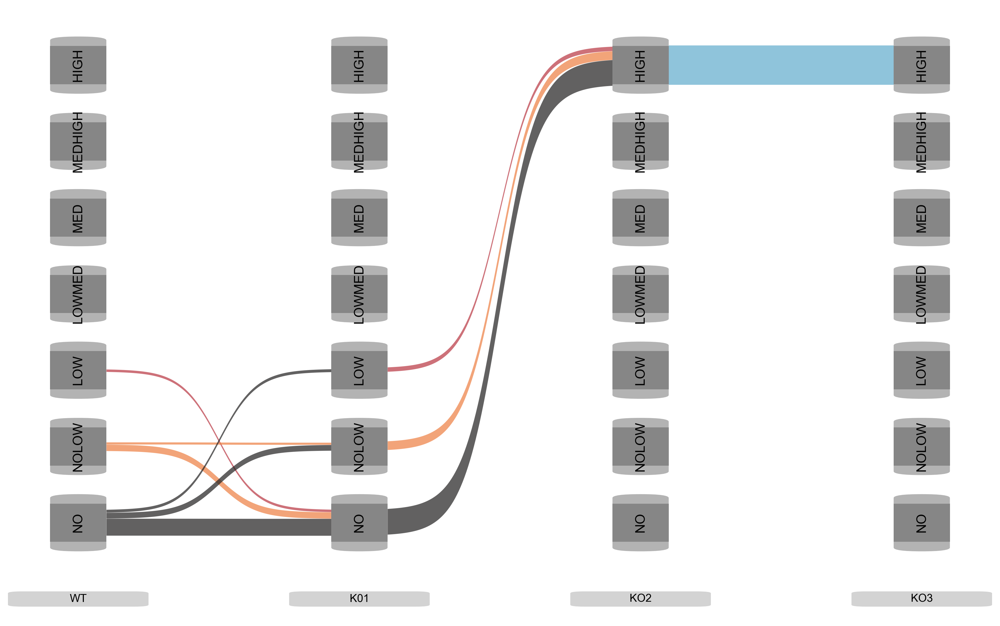

In [16]:

fa_crisp.plot_flows(genes=["TLR4"],min_flow=0.05)
fa_gaussian.plot_flows(genes=["TLR4"],min_flow=0.05)
fa_triangular.plot_flows(genes=["TLR4"],min_flow=0.05)


# Analyse "UP" pattern
The first pattern is analyzed.
First with only the genes changed through the pathways and then pathway enrichment.

In [17]:
# Analyse simulated UP pattern

up_geneset=[]
up_pathways=[]
key=list(pattern_groups.keys())[0]
value=pattern_groups[key]
union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
up_pathways=[list(rp.keys())[pwnames.index(p)] for p in value]
up_geneset_temp = [item for sublist in union_geneset for item in sublist]

relFlows = set().union(*
    [
    fa_crisp.flow_finder(["=", "<<", "="], verbose=True)
    ]
)


up_geneset=set(up_geneset_temp).intersection(changed_genes_list)
genes_to_consider=len(up_geneset)
print(len(up_geneset))

0 (('wildtype', 'HIGH'), ('knockout01', 'HIGH'))
8 (('wildtype', 'MEDHIGH'), ('knockout01', 'MEDHIGH'))
16 (('wildtype', 'MED'), ('knockout01', 'MED'))
24 (('wildtype', 'LOWMED'), ('knockout01', 'LOWMED'))
32 (('wildtype', 'LOW'), ('knockout01', 'LOW'))
40 (('wildtype', 'NOLOW'), ('knockout01', 'NOLOW'))
48 (('wildtype', 'NO'), ('knockout01', 'NO'))
63 (('knockout01', 'MED'), ('knockout02', 'HIGH'))
70 (('knockout01', 'LOWMED'), ('knockout02', 'HIGH'))
71 (('knockout01', 'LOWMED'), ('knockout02', 'MEDHIGH'))
77 (('knockout01', 'LOW'), ('knockout02', 'HIGH'))
78 (('knockout01', 'LOW'), ('knockout02', 'MEDHIGH'))
79 (('knockout01', 'LOW'), ('knockout02', 'MED'))
84 (('knockout01', 'NOLOW'), ('knockout02', 'HIGH'))
85 (('knockout01', 'NOLOW'), ('knockout02', 'MEDHIGH'))
86 (('knockout01', 'NOLOW'), ('knockout02', 'MED'))
87 (('knockout01', 'NOLOW'), ('knockout02', 'LOWMED'))
91 (('knockout01', 'NO'), ('knockout02', 'HIGH'))
92 (('knockout01', 'NO'), ('knockout02', 'MEDHIGH'))
93 (('knocko

In [18]:
module2=["TLR4","HYKK","LACC1","PPP2R5B","CD81","ESYT1"]
print(len(module2))
print(sum([ x in up_geneset for x in module2] ))
print(sum([ x in  set(up_geneset_temp)   for x in module2] ))


confusion_matrix(up_geneset,module2,list(fa_crisp.flows.select(pl.col(fa_crisp.symbol_column)).to_series()),outfile="./confusion_matrices/Genes_pattern1_wgcna.csv")


6
6
6


[[6, 0], [17, 15049]]

In [19]:
scores_df=fa_crisp.calc_coarse_flow_memberships(use_edges=relFlows)
print(scores_df)
fa_crisp.get_confusion_matrix(scores_df,up_geneset,genes_to_consider,outfile="./confusion_matrices/Genes_pattern1_crisp.csv")


shape: (15072, 2)
┌──────────┬────────────┐
│ gene     ┆ membership │
│ ---      ┆ ---        │
│ str      ┆ f64        │
╞══════════╪════════════╡
│ C1orf112 ┆ 0.0        │
│ GCLC     ┆ 0.0        │
│ LAS1L    ┆ 0.0        │
│ ANKIB1   ┆ 0.0        │
│ ...      ┆ ...        │
│ VAC14    ┆ 0.0        │
│ IMPACT   ┆ 0.0        │
│ SOWAHC   ┆ 0.0        │
│ MYH11    ┆ 0.0        │
└──────────┴────────────┘
[[10, 0], [13, 15049]]


In [20]:

genes_to_consider=len(up_geneset)
scores_df=fa_crisp.calc_coarse_flow_memberships(use_edges=relFlows)
fa_crisp.get_confusion_matrix(scores_df,up_geneset,genes_to_consider,outfile="./confusion_matrices/Genes_pattern1_crisp.csv")

scores_df=fa_gaussian.calc_coarse_flow_memberships(use_edges=relFlows)
fa_gaussian.get_confusion_matrix(scores_df,up_geneset,genes_to_consider,outfile="./confusion_matrices/Genes_pattern1_gaussian.csv")

scores_df=fa_triangular.calc_coarse_flow_memberships(use_edges=relFlows)
fa_triangular.get_confusion_matrix(scores_df,up_geneset,genes_to_consider,outfile="./confusion_matrices/Genes_pattern1_triangular.csv")

[[10, 0], [13, 15049]]
[[18, 5], [5, 15044]]
[[18, 5], [5, 15044]]


Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Crisp) Found: 0 / 10 with  0 significant
Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Gaussian) Found: 8 / 10 with  69 significant
Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Triangular) Found: 7 / 10 with  69 significant


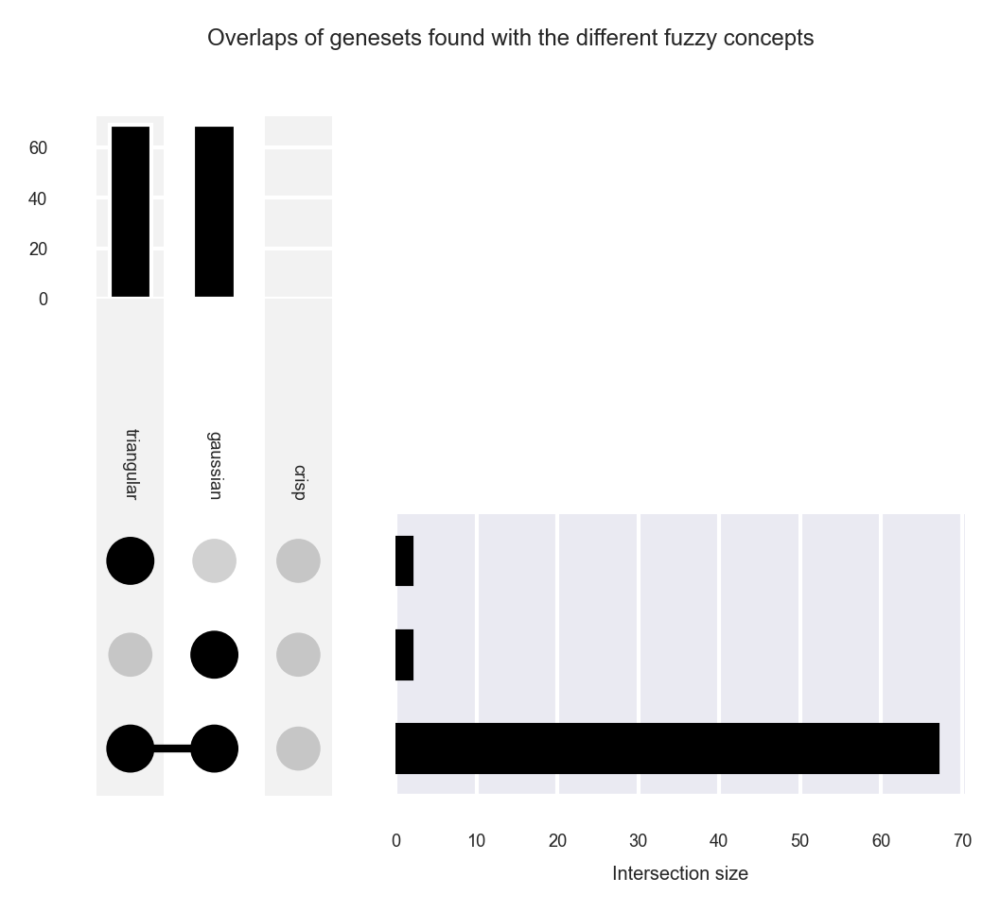

In [21]:

pwScores_crisp = fa_crisp.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_crisp=pwScores_crisp[pwScores_crisp["pw_coverage_adj_pval"]<0.05]
print("Crisp) Found: "+ str(pwScores_signif_crisp[pwScores_signif_crisp["pwid"].isin(up_pathways)].shape[0])+" / "+str(len(up_pathways))+" with  "+ str(pwScores_signif_crisp.shape[0]) +" significant")
confusion_matrix(up_pathways,pwScores_signif_crisp["pwid"],pwScores_crisp["pwid"],outfile="./confusion_matrices/Pathways_pattern1_crisp.csv")

pwScores_gaussian = fa_gaussian.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_gaussian=pwScores_gaussian[pwScores_gaussian["pw_coverage_adj_pval"]<0.05]
print("Gaussian) Found: "+ str(pwScores_signif_gaussian[pwScores_signif_gaussian["pwid"].isin(up_pathways)].shape[0])+" / "+str(len(up_pathways))+" with  "+ str(pwScores_signif_gaussian.shape[0]) +" significant")
confusion_matrix(up_pathways,pwScores_signif_gaussian["pwid"],pwScores_gaussian["pwid"],outfile="./confusion_matrices/Pathways_pattern1_gaussian.csv")

pwScores_triangular = fa_triangular.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_triangular=pwScores_triangular[pwScores_triangular["pw_coverage_adj_pval"]<0.05]
print("Triangular) Found: "+ str(pwScores_signif_triangular[pwScores_signif_triangular["pwid"].isin(up_pathways)].shape[0])+" / "+str(len(up_pathways))+" with  "+ str(pwScores_signif_triangular.shape[0]) +" significant")
confusion_matrix(up_pathways,pwScores_signif_triangular["pwid"],pwScores_triangular["pwid"],outfile="./confusion_matrices/Pathways_pattern1_triangular.csv")

results={ 'triangular': pwScores_signif_triangular["pwid"], 'gaussian': pwScores_signif_gaussian["pwid"], 'crisp': pwScores_signif_crisp["pwid"] }


upset=from_contents(results)
upsetpl = UpSet(upset, orientation='vertical')
upsetpl.plot()    

plt.suptitle("Overlaps of genesets found with the different fuzzy concepts")
plt.show()

# Temp up pattern


In [22]:
# Analyse tUP pattern

tup_geneset=[]
tup_pathways=[]
key=list(pattern_groups.keys())[1]
value=pattern_groups[key]
union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
tup_pathways=[list(rp.keys())[pwnames.index(p)] for p in value]
tup_geneset_temp = [item for sublist in union_geneset for item in sublist]

relFlows = set().union(*
    [

    fa_triangular.flow_finder(["<<", "=", ">>"], verbose=True)
    ]
)
tup_geneset=set(tup_geneset_temp).intersection(changed_genes_list)
genes_to_consider=len(tup_geneset)

print(len(tup_geneset))

14 (('wildtype', 'MED'), ('knockout01', 'HIGH'))
21 (('wildtype', 'LOWMED'), ('knockout01', 'HIGH'))
22 (('wildtype', 'LOWMED'), ('knockout01', 'MEDHIGH'))
28 (('wildtype', 'LOW'), ('knockout01', 'HIGH'))
29 (('wildtype', 'LOW'), ('knockout01', 'MEDHIGH'))
30 (('wildtype', 'LOW'), ('knockout01', 'MED'))
35 (('wildtype', 'NOLOW'), ('knockout01', 'HIGH'))
36 (('wildtype', 'NOLOW'), ('knockout01', 'MEDHIGH'))
37 (('wildtype', 'NOLOW'), ('knockout01', 'MED'))
38 (('wildtype', 'NOLOW'), ('knockout01', 'LOWMED'))
42 (('wildtype', 'NO'), ('knockout01', 'HIGH'))
43 (('wildtype', 'NO'), ('knockout01', 'MEDHIGH'))
44 (('wildtype', 'NO'), ('knockout01', 'MED'))
45 (('wildtype', 'NO'), ('knockout01', 'LOWMED'))
46 (('wildtype', 'NO'), ('knockout01', 'LOW'))
49 (('knockout01', 'HIGH'), ('knockout02', 'HIGH'))
57 (('knockout01', 'MEDHIGH'), ('knockout02', 'MEDHIGH'))
65 (('knockout01', 'MED'), ('knockout02', 'MED'))
73 (('knockout01', 'LOWMED'), ('knockout02', 'LOWMED'))
81 (('knockout01', 'LOW'), (

In [23]:
module1=["IKBKB","ROCK1","ROCK2","RC3H2","ETFB","PRKN","PARK7","TNF","SNX","IL4I1","RC3H1","ATF5","MARK4","MCPH1","PHH","FNBP1L","GGPS1"]
print(len(module1))
print(sum([ x in tup_geneset for x in module1] ))
print(sum([ x in  set(tup_geneset_temp)   for x in module1] ))

confusion_matrix(tup_geneset,module1,list(fa_crisp.flows.select(pl.col(fa_crisp.symbol_column)).to_series()),outfile="./confusion_matrices/Genes_pattern2_wgcna.csv")


17
15
15


[[15, 2], [15, 15040]]

In [24]:

genes_consider=len(tup_geneset)

scores_df=fa_crisp.calc_coarse_flow_memberships(use_edges=relFlows)
fa_crisp.get_confusion_matrix(scores_df,tup_geneset,genes_consider,outfile="./confusion_matrices/Genes_pattern2_crisp.csv")

scores_df=fa_gaussian.calc_coarse_flow_memberships(use_edges=relFlows)
fa_gaussian.get_confusion_matrix(scores_df,tup_geneset,genes_consider,outfile="./confusion_matrices/Genes_pattern2_gaussian.csv")

scores_df=fa_triangular.calc_coarse_flow_memberships(use_edges=relFlows)
fa_triangular.get_confusion_matrix(scores_df,tup_geneset,genes_consider,outfile="./confusion_matrices/Genes_pattern2_triangular.csv")

[[30, 0], [0, 15042]]
[[26, 4], [4, 15038]]
[[27, 3], [3, 15039]]


Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Crisp) Found: 5 / 10 with  11 significant
Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Gaussian) Found: 10 / 10 with  183 significant
Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Triangular) Found: 10 / 10 with  195 significant


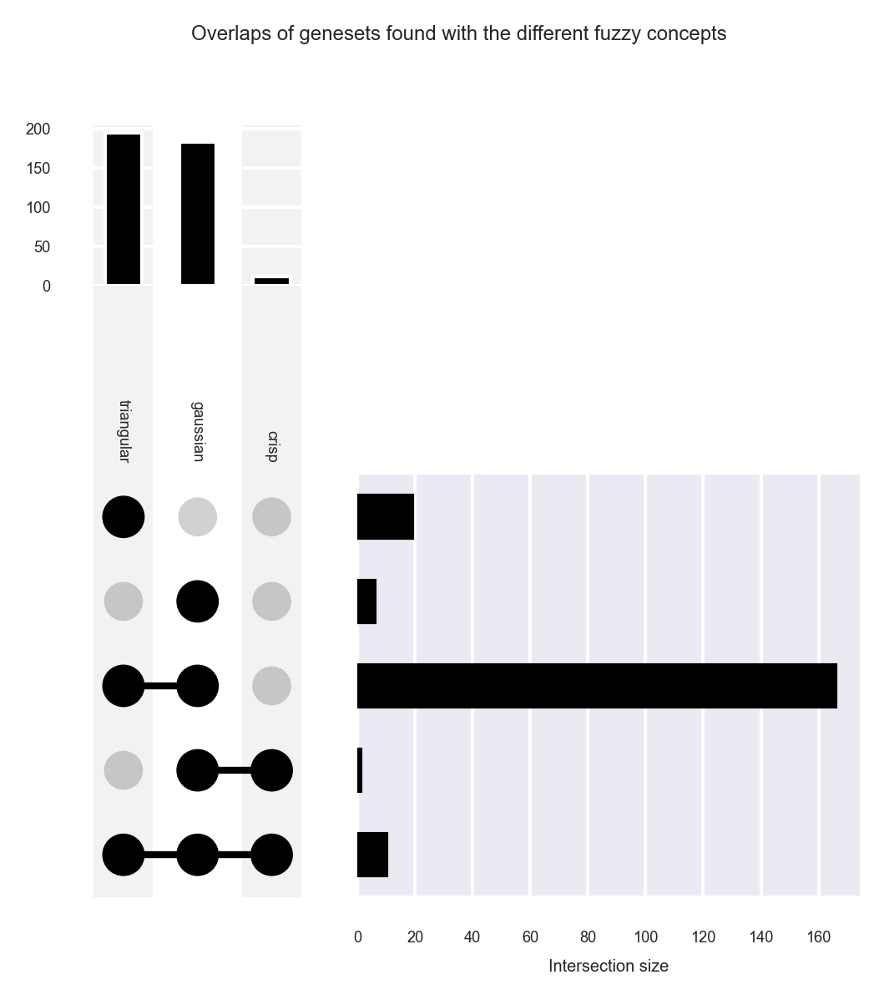

In [25]:

pwScores_crisp = fa_crisp.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_crisp=pwScores_crisp[pwScores_crisp["pw_coverage_adj_pval"]<0.05]
print("Crisp) Found: "+ str(pwScores_signif_crisp[pwScores_signif_crisp["pwid"].isin(tup_pathways)].shape[0])+" / "+str(len(tup_pathways))+" with  "+ str(pwScores_signif_crisp.shape[0]) +" significant")
confusion_matrix(tup_pathways,pwScores_signif_crisp["pwid"],pwScores_crisp["pwid"],outfile="./confusion_matrices/Pathways_pattern2_crisp.csv")

pwScores_gaussian = fa_gaussian.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_gaussian=pwScores_gaussian[pwScores_gaussian["pw_coverage_adj_pval"]<0.05]
print("Gaussian) Found: "+ str(pwScores_signif_gaussian[pwScores_signif_gaussian["pwid"].isin(tup_pathways)].shape[0])+" / "+str(len(tup_pathways))+" with  "+ str(pwScores_signif_gaussian.shape[0]) +" significant")
confusion_matrix(tup_pathways,pwScores_signif_gaussian["pwid"],pwScores_gaussian["pwid"],outfile="./confusion_matrices/Pathways_pattern2_gaussian.csv")

pwScores_triangular = fa_triangular.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_triangular=pwScores_triangular[pwScores_triangular["pw_coverage_adj_pval"]<0.05]
print("Triangular) Found: "+ str(pwScores_signif_triangular[pwScores_signif_triangular["pwid"].isin(tup_pathways)].shape[0])+" / "+str(len(tup_pathways))+" with  "+ str(pwScores_signif_triangular.shape[0]) +" significant")
confusion_matrix(tup_pathways,pwScores_signif_triangular["pwid"],pwScores_triangular["pwid"],outfile="./confusion_matrices/Pathways_pattern2_triangular.csv")

results={ 'triangular': pwScores_signif_triangular["pwid"], 'gaussian': pwScores_signif_gaussian["pwid"], 'crisp': pwScores_signif_crisp["pwid"] }


upset=from_contents(results)
upsetpl = UpSet(upset, orientation='vertical')
upsetpl.plot()    

plt.suptitle("Overlaps of genesets found with the different fuzzy concepts")
plt.show()

# DOWN pattern

In [26]:
# Analyse simulated DOWN pattern

down_geneset=[]
down_pathways=[]
key=list(pattern_groups.keys())[2]
value=pattern_groups[key]
union_geneset=[rp[list(rp.keys())[pwnames.index(p)]][1] for p in value]
down_pathways=[list(rp.keys())[pwnames.index(p)] for p in value]
down_geneset = [item for sublist in union_geneset for item in sublist]

relFlows = set().union(*
    [
    fa_triangular.flow_finder(["=", ">>", "="], verbose=True)
    ]
)

down_geneset=set(down_geneset).intersection(changed_genes_list)
genes_to_consider=len(down_geneset)

print(len(down_geneset))

0 (('wildtype', 'HIGH'), ('knockout01', 'HIGH'))
8 (('wildtype', 'MEDHIGH'), ('knockout01', 'MEDHIGH'))
16 (('wildtype', 'MED'), ('knockout01', 'MED'))
24 (('wildtype', 'LOWMED'), ('knockout01', 'LOWMED'))
32 (('wildtype', 'LOW'), ('knockout01', 'LOW'))
40 (('wildtype', 'NOLOW'), ('knockout01', 'NOLOW'))
48 (('wildtype', 'NO'), ('knockout01', 'NO'))
51 (('knockout01', 'HIGH'), ('knockout02', 'MED'))
52 (('knockout01', 'HIGH'), ('knockout02', 'LOWMED'))
53 (('knockout01', 'HIGH'), ('knockout02', 'LOW'))
54 (('knockout01', 'HIGH'), ('knockout02', 'NOLOW'))
55 (('knockout01', 'HIGH'), ('knockout02', 'NO'))
59 (('knockout01', 'MEDHIGH'), ('knockout02', 'LOWMED'))
60 (('knockout01', 'MEDHIGH'), ('knockout02', 'LOW'))
61 (('knockout01', 'MEDHIGH'), ('knockout02', 'NOLOW'))
62 (('knockout01', 'MEDHIGH'), ('knockout02', 'NO'))
67 (('knockout01', 'MED'), ('knockout02', 'LOW'))
68 (('knockout01', 'MED'), ('knockout02', 'NOLOW'))
69 (('knockout01', 'MED'), ('knockout02', 'NO'))
75 (('knockout01',

In [27]:

gene_to_consider=len(down_geneset)
scores_df=fa_crisp.calc_coarse_flow_memberships(use_edges=relFlows)
fa_crisp.get_confusion_matrix(scores_df,down_geneset,gene_to_consider,outfile="./confusion_matrices/Genes_pattern3_crisp.csv")

scores_df=fa_gaussian.calc_coarse_flow_memberships(use_edges=relFlows)
fa_gaussian.get_confusion_matrix(scores_df,down_geneset,gene_to_consider,outfile="./confusion_matrices/Genes_pattern3_gaussian.csv")

scores_df=fa_triangular.calc_coarse_flow_memberships(use_edges=relFlows)
fa_triangular.get_confusion_matrix(scores_df,down_geneset,gene_to_consider,outfile="./confusion_matrices/Genes_pattern3_triangular.csv")

[[0, 0], [16, 15056]]
[[12, 4], [4, 15052]]
[[5, 11], [11, 15045]]


Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Crisp) Found: 0 / 10 with  0 significant
Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Gaussian) Found: 10 / 10 with  26 significant
Loading pathways from go_human_filtered.bp.gmt
Identified 9175 pathways
Calculating p-values for groups [1, 2, 3, 4, 10, 50, 100, 1226]
Triangular) Found: 10 / 10 with  45 significant


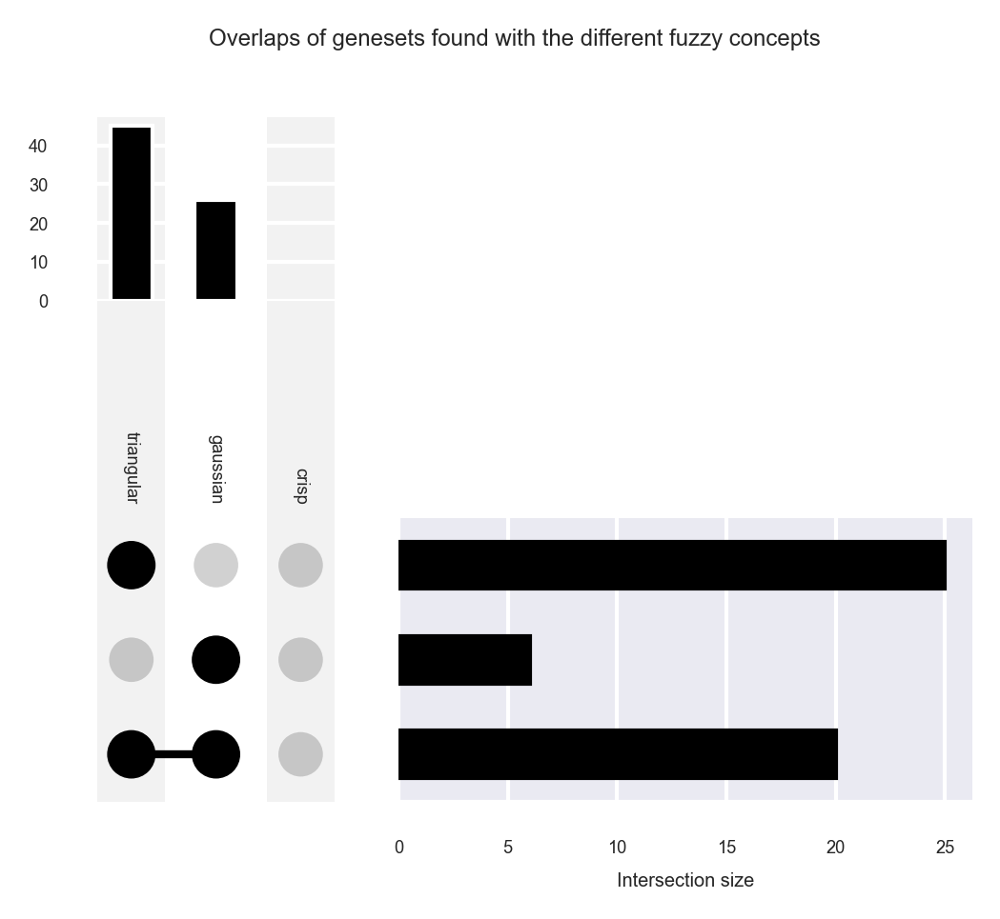

In [28]:

pwScores_crisp = fa_crisp.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_crisp=pwScores_crisp[pwScores_crisp["pw_coverage_adj_pval"]<0.05]
print("Crisp) Found: "+ str(pwScores_signif_crisp[pwScores_signif_crisp["pwid"].isin(down_pathways)].shape[0])+" / "+str(len(down_pathways))+" with  "+ str(pwScores_signif_crisp.shape[0]) +" significant")
confusion_matrix(down_pathways,pwScores_signif_crisp["pwid"],pwScores_crisp["pwid"],outfile="./confusion_matrices/Pathways_pattern3_crisp.csv")

pwScores_gaussian = fa_gaussian.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_gaussian=pwScores_gaussian[pwScores_gaussian["pw_coverage_adj_pval"]<0.05]
print("Gaussian) Found: "+ str(pwScores_signif_gaussian[pwScores_signif_gaussian["pwid"].isin(down_pathways)].shape[0])+" / "+str(len(down_pathways))+" with  "+ str(pwScores_signif_gaussian.shape[0]) +" significant")
confusion_matrix(down_pathways,pwScores_signif_gaussian["pwid"],pwScores_gaussian["pwid"],outfile="./confusion_matrices/Pathways_pattern3_gaussian.csv")

pwScores_triangular = fa_triangular.analyse_pathways(use_edges=relFlows,genesets_file=pw_file)
pwScores_signif_triangular=pwScores_triangular[pwScores_triangular["pw_coverage_adj_pval"]<0.05]
print("Triangular) Found: "+ str(pwScores_signif_triangular[pwScores_signif_triangular["pwid"].isin(down_pathways)].shape[0])+" / "+str(len(down_pathways))+" with  "+ str(pwScores_signif_triangular.shape[0]) +" significant")
confusion_matrix(down_pathways,pwScores_signif_triangular["pwid"],pwScores_triangular["pwid"],outfile="./confusion_matrices/Pathways_pattern3_triangular.csv")

results={ 'triangular': pwScores_signif_triangular["pwid"], 'gaussian': pwScores_signif_gaussian["pwid"], 'crisp': pwScores_signif_crisp["pwid"] }


upset=from_contents(results)
upsetpl = UpSet(upset, orientation='vertical')
upsetpl.plot()    

plt.suptitle("Overlaps of genesets found with the different fuzzy concepts")
plt.show()







/home/o/offensperger/tmp/ipykernel_57197/2369286389.py:11: RuntimeWarning: invalid value encountered in scalar divide
  precision=cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
/home/o/offensperger/tmp/ipykernel_57197/2369286389.py:13: RuntimeWarning: invalid value encountered in scalar divide
  sensitivity = cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
/home/o/offensperger/tmp/ipykernel_57197/2369286389.py:11: RuntimeWarning: invalid value encountered in scalar divide
  precision=cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
/home/o/offensperger/tmp/ipykernel_57197/2369286389.py:13: RuntimeWarning: invalid value encountered in scalar divide
  sensitivity = cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
/home/o/offensperger/tmp/ipykernel_57197/2369286389.py:11: RuntimeWarning: invalid value encountered in scalar divide
  precision=cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
/home/o/offensperger/tmp/ipykernel_57197/2369286389.py:13: RuntimeWarning: invalid value encountered in scalar divide
  se

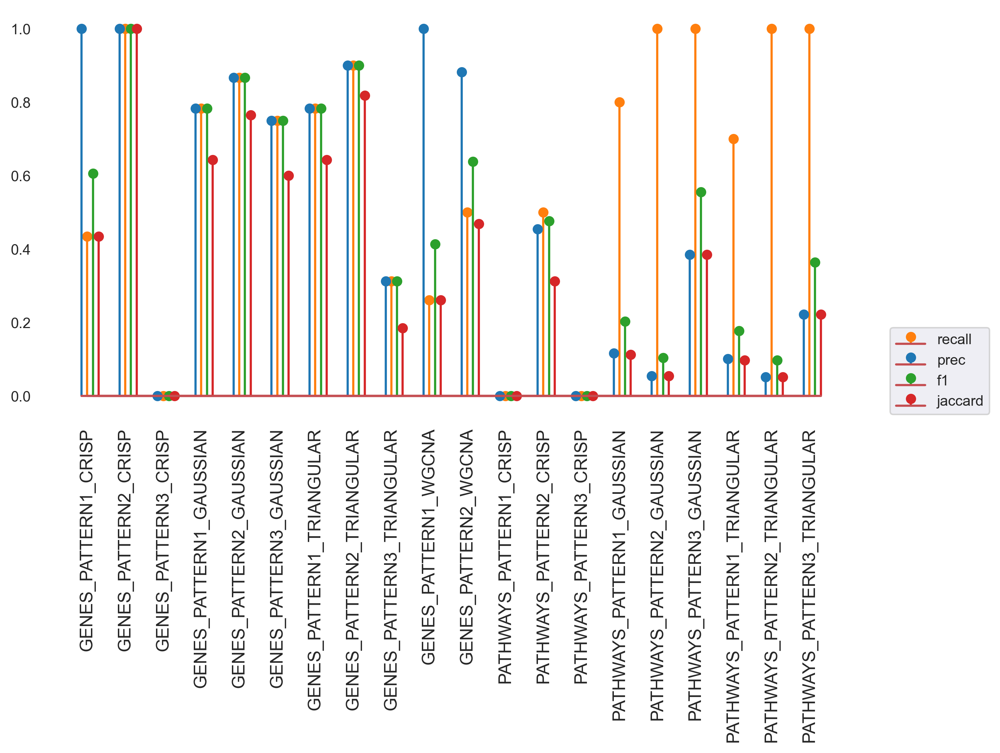

In [29]:

import os
cm_folder="./confusion_matrices"
files = [f for f in os.listdir(cm_folder) if os.path.isfile(join(cm_folder, f))]
files

def get_stats(file):
    cm1=pd.read_csv(cm_folder+"/"+file,header=0,index_col=0)
    total=cm1.sum(axis=1 ).sum(axis=0 )
    #####from confusion matrix calculate accuracy
    accuracy=(cm1.iloc[0,0]+cm1.iloc[1,1])/total
    precision=cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
    recall=cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[1,0])
    sensitivity = cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1])
    specificity = cm1.iloc[1,1]/(cm1.iloc[1,0]+cm1.iloc[1,1])
    f1=2*cm1.iloc[0,0]/(2*cm1.iloc[0,0]+cm1.iloc[1,0]+cm1.iloc[0,1])
    jaccard=cm1.iloc[0,0]/(cm1.iloc[0,0]+cm1.iloc[0,1]+cm1.iloc[1,0])

    return(file,accuracy,sensitivity,specificity,f1,precision,recall,jaccard)

df = pd.DataFrame(columns=['acc','sens','spec','f1','precision','recall','jaccard'], index=files)

for file in files:
    file,accuracy,sensitivity,specificity,f1,precision,recall,jaccard=get_stats(file)
    df.loc[file] = pd.Series({'acc':accuracy, 'sens':sensitivity, 'spec':specificity, 'f1':f1,'precision':precision,'recall':recall,'jaccard':jaccard})
df=df.sort_index()

df=df.fillna(0)
df["short_name"]=[x.split(".")[0].upper() for x in df.index]
df["cond1"]=[x.split("_")[0] for x in df["short_name"]]
df["cond2"]=[x.split("_")[1] for x in df["short_name"]]
df["cond3"]=[x.split("_")[2] for x in df["short_name"] ]

df=df.sort_values(['cond1', 'cond3'], ascending=[True, True])


my_range=np.arange(len(df.index))
fig = plt.figure(figsize=(10, 5))
ax = plt.axes()
ax.set_facecolor("white")
plt.grid(True,axis="y")
#plt.stem(my_range-0.3,df['acc'],'r',label="acc")
#plt.stem(my_range-0.15,df['spec'],"b",label="spec")
plt.stem(my_range,df['recall'],"tab:orange",label="recall")
plt.stem(my_range-0.15,df['precision'],"tab:blue",label="prec")
plt.stem(my_range+0.15,df['f1'],"tab:green",label="f1")
plt.stem(my_range+0.3,df['jaccard'],"tab:red",label="jaccard")


plt.xticks( my_range, df['short_name'], rotation = 90,)
plt.legend(loc=(1.04, 0),fontsize=10)

plt.xticks(size = 12)
plt.yticks(size = 10)
plt.savefig('./benchmark.pdf', bbox_inches='tight')
    

In [30]:
print(df)

                                       acc      sens      spec        f1  \
Genes_pattern1_crisp.csv          0.999137  1.000000  0.999137  0.606061   
Genes_pattern2_crisp.csv          1.000000  1.000000  1.000000  1.000000   
Genes_pattern3_crisp.csv          0.998938  0.000000  0.998938  0.000000   
Genes_pattern1_gaussian.csv       0.999337  0.782609  0.999668  0.782609   
Genes_pattern2_gaussian.csv       0.999469  0.866667  0.999734  0.866667   
Genes_pattern3_gaussian.csv       0.999469  0.750000  0.999734  0.750000   
Genes_pattern1_triangular.csv     0.999337  0.782609  0.999668  0.782609   
Genes_pattern2_triangular.csv     0.999602  0.900000  0.999801  0.900000   
Genes_pattern3_triangular.csv     0.998540  0.312500  0.999269  0.312500   
Genes_pattern1_wgcna.csv          0.998872  1.000000  0.998872  0.413793   
Genes_pattern2_wgcna.csv          0.998872  0.882353  0.999004  0.638298   
Pathways_pattern1_crisp.csv       0.998910  0.000000  0.998910  0.000000   
Pathways_pat